### 구글 드라이브 마운트

In [ ]:
from google.colab import drive 
drive.mount('/content/gdrive/')

Mounted at /content/gdrive/


# 0. Import

In [ ]:
# 폰트 설치용
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following NEW packages will be installed:
  fonts-nanum
0 upgraded, 1 newly installed, 0 to remove and 39 not upgraded.
Need to get 9,604 kB of archives.
After this operation, 29.5 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 fonts-nanum all 20170925-1 [9,604 kB]
Fetched 9,604 kB in 1s (10.1 MB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package fonts-nanum.
(Reading database ... 160772 files and di

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
plt.rc('font', family='NanumBarunGothic') 
from matplotlib.colors import rgb2hex
from matplotlib.colors import ListedColormap
import matplotlib
get_ipython().run_line_magic('config', "InlineBackend.figure_format='retina' #화질 좋게 해주기")
import plotly.express as px
import plotly.offline as pyo
import plotly.graph_objs as go
import sklearn
import seaborn as sb
import plotly.io as pio
import warnings
warnings.filterwarnings(action='ignore') 
import statsmodels.api as sm
import statsmodels.formula.api as smf

from scipy.stats import norm
import scipy.stats as stats

# 1. Data Preprocessing

## 내부 데이터

In [ ]:
dat = '/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/내부 데이터/'

# 데이터 읽는 함수 만들기

buycol = ['date', 'sex', 'age', 'bigcat', 'smcat', 'qty']
snscol = ['date', 'bigcat', 'smcat', 'cnt']

def read_buy(df):
    df = pd.read_csv(df +".csv")
    df = df.drop('Unnamed: 0', axis=1)
    df.columns = buycol
    return df
    
def read_sns(df):
    df = pd.read_csv(df +".csv")
    df = df.drop('Unnamed: 0', axis=1)
    df.columns = snscol
    return df

In [ ]:
buy1 = read_buy(dat+"buy2018_1")
buy2 = read_buy(dat+"buy2018_2")
buy3 = read_buy(dat+"buy2019_1")
buy4 = read_buy(dat+"buy2019_2")
buy = pd.concat([buy1, buy2, buy3, buy4])

In [ ]:
sns1 = read_sns(dat+"sns2018_1")
sns2 = read_sns(dat+"sns2018_2")
sns3 = read_sns(dat+"sns2019_1")
sns4 = read_sns(dat+"sns2019_2")
sns = pd.concat([sns1, sns2, sns3, sns4])

In [ ]:
# datetime으로 바꾸기
from datetime import datetime
buy['date'] = pd.to_datetime(buy['date'], format='%Y%m%d')
sns['date'] = pd.to_datetime(sns['date'], format='%Y%m%d')

findfont: Font family ['NanumBarunGothic'] not found. Falling back to DejaVu Sans.
findfont: Font family ['NanumBarunGothic'] not found. Falling back to DejaVu Sans.


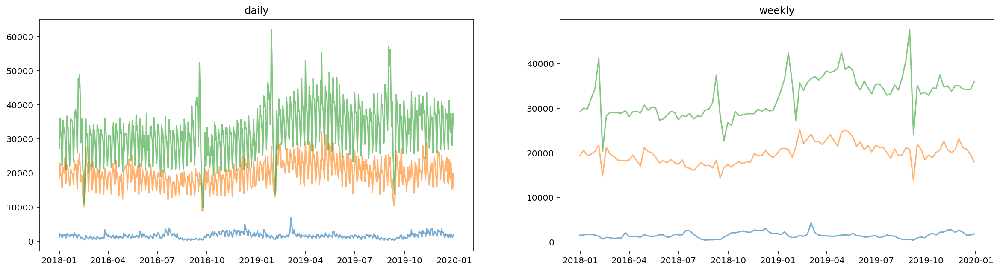

<Figure size 720x360 with 0 Axes>

In [ ]:
# 각 카테고리 별 총합
fig, ax = plt.subplots(1,2,figsize=(20,5))

# 주별로 묶기 전
df = buy.groupby(['date','bigcat']).sum().reset_index()
for i in df['bigcat'].unique().tolist():
    d_ = df[(df["bigcat"]==i)]
    ax[0].plot(d_["date"], d_["qty"], "-", alpha=.6)
ax[0].set_title('daily')

# 주별로 묶은 뒤
df = df.set_index('date')
plt.figure(figsize=(10,5))
for i in df['bigcat'].unique().tolist():
    d_ = df[(df["bigcat"]==i)]
    d_ = d_.resample('W', label='left').mean().reset_index() # 주 단위로 묶어주기
    ax[1].plot(d_["date"], d_["qty"], "-", alpha=.6)
ax[1].set_title('weekly')

plt.tight_layout()

- 주별 트렌드가 명확해, 주별로 묶어 평균을 내어 계절성을 제거하고자 하였습니다.

## 외부 데이터: 날씨

In [ ]:
# 사전에 전처리한 데이터들 합차기
df1 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/날씨 데이터/기온강수.csv')
df2 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/날씨 데이터/기온습도열지수_서울.csv')
df3 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/날씨 데이터/대기오염_서울.csv')

In [ ]:
# datetime으로 바꾸기
from datetime import datetime
df2['일자'] = pd.to_datetime(df2['일자'], format='%Y%m%d')

# merge를 위해 str로 바꾸기
df1['일자'] = df1['일시'].astype(str)
df2['일자'] = df2['일자'].astype(str)
df3['일자'] = df3['측정일자'].astype(str)

# 하나의 데이터로 합치기
from functools import reduce
dfs = [df1,df2,df3]
df_merge = reduce(lambda left, right: pd.merge(left, right, on='일자', how='outer'), dfs)

In [ ]:
# 필요없는 컬럼 삭제
df_merge = df_merge.drop(['Unnamed: 0_x','Unnamed: 0_y','측정일자', '일자','기온(°C)_y'], axis=1)

# 컬럼명 변경
df_merge = df_merge.rename({'일시':'일자', '기온(°C)_x':'기온(°C)'}, axis='columns')

# datetime으로 바꾸기
df_merge['일자'] = pd.to_datetime(df_merge['일자'], format='%Y-%m-%d')
df_merge.to_csv('climate.csv', index=False)

In [ ]:
# 날씨자료 수정(대기오염)
data_2018 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/원본 데이터/날씨 데이터/대기오염/일평균_대기환경_정보_2018년.csv')
data_2019 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/원본 데이터/날씨 데이터/대기오염/일평균_대기환경_정보_2019년.csv')

# 자료 합치기
data_air = pd.concat([data_2018, data_2019], axis=0)
data_air = data_air.loc[:,data_air.columns[2:]]
data_air.columns = ['미세먼지(㎍/㎥)', '초미세먼지(㎍/㎥)', '오존(ppm)', '이산화질소농도(ppm)', '일산화탄소농도(ppm)', '아황산가스농도(ppm)']
data_air.reset_index(drop=True,inplace=True)

In [ ]:
# 기존 climate 불러오기
df_climate = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/날씨 데이터/climate.csv')

# 기존 climate 분할
df_climate_1 = df_climate.loc[:,df_climate.columns[1:9]]
df_climate_2 = df_climate.loc[:,df_climate.columns[15:17]]

# 수정된 자료 넣고 합치기
data_climate = [df_climate_1, data_air, df_climate_2]
data_climate = reduce(lambda  left,right: pd.concat([left,right],
                                            axis=1), data_climate)
data_climate

#os.chdir('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/날씨 데이터')
#data_climate.to_csv('climate2.csv')

,일자,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),기온(°F),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 )
0,2018-01-01,-1.283333,-5.1,3.8,0.000000,29.7,39.3,-1.28,33,18,0.015,0.029,0.6,0.005,0.346667,0.049667
1,2018-01-02,-1.491667,-4.3,1.8,0.000000,29.3,43.7,-1.49,32,20,0.012,0.036,0.8,0.005,0.350000,0.047000
2,2018-01-03,-4.479167,-7.1,-0.4,0.000000,23.9,41.2,-4.48,30,18,0.018,0.021,0.5,0.005,0.363333,0.066333
3,2018-01-04,-4.800000,-8.7,-0.7,0.000000,23.4,44.1,-4.80,39,24,0.009,0.036,0.7,0.005,0.333333,0.056333
4,2018-01-05,-2.912500,-5.6,1.6,0.000000,26.8,48.5,-2.91,48,33,0.006,0.044,0.8,0.005,0.223333,0.043333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
725,2019-12-27,-1.750000,-4.6,2.6,0.000000,28.9,46.9,-1.75,33,25,0.019,0.028,0.6,0.004,0.297000,0.048000
726,2019-12-28,0.891667,-3.6,6.1,0.000000,33.6,47.6,0.89,42,28,0.004,0.045,0.8,0.005,0.353000,0.051333
727,2019-12-29,3.504167,1.1,6.2,0.016667,38.3,49.6,3.50,43,29,0.007,0.038,0.7,0.004,0.185667,0.037333
728,2019-12-30,3.516667,-5.7,6.8,0.058333,38.3,71.5,3.52,37,27,0.010,0.035,0.8,0.004,0.203333,0.037667


In [ ]:
# 자료 추가 (풍속, 구름 데이터)
data_2018 = pd.read_csv("/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/원본 데이터/날씨 데이터/2018풍속눈구름.csv", encoding='cp949')
data_2019 = pd.read_csv("/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/원본 데이터/날씨 데이터/2019풍속눈구름.csv", encoding='cp949')

data_all = pd.concat([data_2018, data_2019], ignore_index=True)
data_all = data_all.drop(['적설(cm)', '지점', '지점명'], axis=1)

from datetime import datetime
data_all['일시'] = pd.to_datetime(data_all['일시'])
data_all['일시'] = data_all['일시'].dt.floor('D')

# 결측치는 0으로 간주
data_all = data_all.fillna(0)

# 시간 별 풍속, 전운량을 평균내어 일별 데이터로 생성
newdata = data_all.groupby('일시').mean().reset_index()

In [ ]:
# 최종데이터 climate3
climate3 = pd.concat([data_climate, newdata], axis = 1)
climate3 = climate3.drop(['일시'], axis=1)
climate3
# climate3.to_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/날씨 데이터/climate3.csv', index=False)

,일자,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),기온(°F),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
0,2018-01-01,-1.283333,-5.1,3.8,0.000000,29.7,39.3,-1.28,33,18,0.015,0.029,0.6,0.005,0.346667,0.049667,1.454167,0.875000
1,2018-01-02,-1.491667,-4.3,1.8,0.000000,29.3,43.7,-1.49,32,20,0.012,0.036,0.8,0.005,0.350000,0.047000,1.766667,0.416667
2,2018-01-03,-4.479167,-7.1,-0.4,0.000000,23.9,41.2,-4.48,30,18,0.018,0.021,0.5,0.005,0.363333,0.066333,2.125000,3.375000
3,2018-01-04,-4.800000,-8.7,-0.7,0.000000,23.4,44.1,-4.80,39,24,0.009,0.036,0.7,0.005,0.333333,0.056333,1.375000,4.666667
4,2018-01-05,-2.912500,-5.6,1.6,0.000000,26.8,48.5,-2.91,48,33,0.006,0.044,0.8,0.005,0.223333,0.043333,1.658333,3.958333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
725,2019-12-27,-1.750000,-4.6,2.6,0.000000,28.9,46.9,-1.75,33,25,0.019,0.028,0.6,0.004,0.297000,0.048000,2.225000,0.000000
726,2019-12-28,0.891667,-3.6,6.1,0.000000,33.6,47.6,0.89,42,28,0.004,0.045,0.8,0.005,0.353000,0.051333,1.987500,2.583333
727,2019-12-29,3.504167,1.1,6.2,0.016667,38.3,49.6,3.50,43,29,0.007,0.038,0.7,0.004,0.185667,0.037333,2.883333,8.416667
728,2019-12-30,3.516667,-5.7,6.8,0.058333,38.3,71.5,3.52,37,27,0.010,0.035,0.8,0.004,0.203333,0.037667,2.737500,8.000000


## 모델링 위한 데이터 전처리

In [ ]:
# drink만 따로 추출
buy_drink = buy[buy['smcat'].str.contains('차|아이스티|밀크티|음료|커피|코코아|즙|식혜|요거트|탄산수|우유|주스|밀크|음용식초|두유|생수')].reset_index()
buy_drink = buy_drink.drop(['index','bigcat'], axis=1)

sns_drink = sns[sns['smcat'].str.contains('차|아이스티|밀크티|음료|커피|코코아|즙|식혜|요거트|탄산수|우유|주스|밀크|음용식초|두유|생수')].reset_index()
sns_drink = sns_drink.drop(['index','bigcat'], axis=1)

In [ ]:
# 날씨 데이터 불러오기
climate = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/날씨 데이터/climate3.csv')

In [ ]:
# merge하기 위해 따로 string으로 바꿔주기
buy_drink['date'] = buy_drink['date'].astype(str)
sns_drink['date'] = sns_drink['date'].astype(str)
climate['일자'] = climate['일자'].astype(str)

In [ ]:
# 데이터 구축
all = pd.merge(buy_drink, sns_drink, on=['date','smcat'])
df = buy_drink.groupby(['date', 'sex', 'age']).count().reset_index()
df = df.drop(['smcat', 'qty'], axis=1)

for i in buy_drink['smcat'].unique().tolist():
  df1 = all[all['smcat']==i]
  df = pd.merge(df, df1, on=['date','sex','age'], how='outer')
  df = df.drop('smcat', axis=1)
  cntname = i + ' sns'
  df = df.rename({'qty': i, 'cnt': cntname}, axis='columns')

# 결측치 처리된 데이터 0으로 바꿔주기
model_drink_data = df.fillna(0)
model_drink_data.head()

,date,sex,age,건강즙,건강즙 sns,건강즙/녹용,건강즙/녹용 sns,곡물차,곡물차 sns,과실차,과실차 sns,과채 음료/주스,과채 음료/주스 sns,기타 주스류,기타 주스류 sns,녹차,녹차 sns,더치커피,더치커피 sns,두유,두유 sns,둥굴레차,둥굴레차 sns,딸기우유,딸기우유 sns,밀크티/티라떼,밀크티/티라떼 sns,바나나우유,바나나우유 sns,배/포도/과일즙,배/포도/과일즙 sns,보리차,보리차 sns,복분자/석류/과실즙,복분자/석류/과실즙 sns,비타민/화이바 음료,비타민/화이바 음료 sns,생수,생수 sns,숙취/에너지/건강 음료,...,유자차,유자차 sns,유제품 음료,유제품 음료 sns,율무차,율무차 sns,이온음료,이온음료 sns,인스턴트커피,인스턴트커피 sns,저/무지방우유,저/무지방우유 sns,전통차,전통차 sns,차 선물세트,차 선물세트 sns,차/곡물 음료,차/곡물 음료 sns,초코우유,초코우유 sns,캡슐/POD커피,캡슐/POD커피 sns,커피용 프림,커피용 프림 sns,커피음료,커피음료 sns,코코아/핫초코,코코아/핫초코 sns,탄산수,탄산수 sns,탄산음료,탄산음료 sns,허브차,허브차 sns,홍삼 음료,홍삼 음료 sns,홍차,홍차 sns,흰우유,흰우유 sns
0,2018-01-01,F,20,2.0,1.084998,6.0,2.340895,2.0,0.0,16.0,0.0,55.0,0.312371,18.0,63.841585,2.0,79.215375,7.0,8.267435,89,21.404825,3.0,0.945999,5.0,16.224804,57.0,51.266983,41.0,14.193385,24.0,0.601645,1.0,13.888471,17.0,17.742059,43.0,4.337982,134,30.400784,18.0,...,11.0,14.830116,225.0,0.686319,4.0,2.0857,12.0,1.643678,52,2.135917,8.0,2.86776,17.0,1.748682,5.0,59.589144,6.0,26.992458,86.0,7.310201,12.0,32.767249,0.0,0.000000,619.0,0.697679,18.0,44.102819,23.0,10.9321,175.0,12.877921,28.0,2.063065,0.0,0.00000,6.0,24.731924,33.0,3.133769
1,2018-01-01,F,30,10.0,1.084998,17.0,2.340895,22.0,0.0,14.0,0.0,105.0,0.312371,53.0,63.841585,3.0,79.215375,12.0,8.267435,216,21.404825,9.0,0.945999,21.0,16.224804,65.0,51.266983,15.0,14.193385,52.0,0.601645,11.0,13.888471,39.0,17.742059,11.0,4.337982,362,30.400784,21.0,...,24.0,14.830116,459.0,0.686319,1.0,2.0857,18.0,1.643678,184,2.135917,37.0,2.86776,122.0,1.748682,4.0,59.589144,18.0,26.992458,6.0,7.310201,47.0,32.767249,1.0,1.465359,629.0,0.697679,20.0,44.102819,73.0,10.9321,179.0,12.877921,37.0,2.063065,1.0,1.02581,5.0,24.731924,260.0,3.133769
2,2018-01-01,F,40,13.0,1.084998,18.0,2.340895,22.0,0.0,7.0,0.0,30.0,0.312371,19.0,63.841585,10.0,79.215375,6.0,8.267435,148,21.404825,4.0,0.945999,11.0,16.224804,16.0,51.266983,8.0,14.193385,43.0,0.601645,9.0,13.888471,30.0,17.742059,3.0,4.337982,195,30.400784,8.0,...,21.0,14.830116,219.0,0.686319,6.0,2.0857,8.0,1.643678,179,2.135917,28.0,2.86776,191.0,1.748682,4.0,59.589144,13.0,26.992458,1.0,7.310201,33.0,32.767249,1.0,1.465359,222.0,0.697679,20.0,44.102819,20.0,10.9321,77.0,12.877921,30.0,2.063065,0.0,0.00000,5.0,24.731924,82.0,3.133769
3,2018-01-01,F,50,3.0,1.084998,6.0,2.340895,7.0,0.0,3.0,0.0,14.0,0.312371,4.0,63.841585,3.0,79.215375,3.0,8.267435,70,21.404825,1.0,0.945999,2.0,16.224804,3.0,51.266983,0.0,0.000000,16.0,0.601645,1.0,13.888471,17.0,17.742059,5.0,4.337982,80,30.400784,4.0,...,4.0,14.830116,52.0,0.686319,5.0,2.0857,2.0,1.643678,91,2.135917,9.0,2.86776,84.0,1.748682,1.0,59.589144,2.0,26.992458,0.0,0.000000,13.0,32.767249,0.0,0.000000,35.0,0.697679,0.0,0.000000,13.0,10.9321,28.0,12.877921,10.0,2.063065,0.0,0.00000,1.0,24.731924,27.0,3.133769
4,2018-01-01,F,60,0.0,0.000000,0.0,0.000000,1.0,0.0,3.0,0.0,5.0,0.312371,3.0,63.841585,1.0,79.215375,0.0,0.000000,19,21.404825,0.0,0.000000,0.0,0.000000,1.0,51.266983,0.0,0.000000,3.0,0.601645,3.0,13.888471,7.0,17.742059,0.0,0.000000,22,30.400784,2.0,...,2.0,14.830116,9.0,0.686319,1.0,2.0857,1.0,1.643678,13,2.135917,2.0,2.86776,16.0,1.748682,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000000,9.0,0.697679,1.0,44.102819,3.0,10.9321,9.0,12.877921,4.0,2.063065,0.0,0.00000,1.0,24.731924,8.0,3.133769


In [ ]:
model_drink_data.to_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/model_drink_data.csv', index=False)

# 2. EDA

## 전체 데이터 살펴보기

In [ ]:
# 소비 데이터 전처리
buyall = buy.groupby('date').sum().reset_index()
df = buy.groupby(['date','bigcat']).sum().reset_index()
buy_nnb = df[df['bigcat']=='냉난방가전']
buy_bt = df[df['bigcat']=='뷰티']
buy_food = df[df['bigcat']=='식품']

# 날씨 데이터 전처리
# datetime으로 다시 바꿔주기
climate['일자'] = pd.to_datetime(climate['일자'], format='%Y-%m-%d')

In [ ]:
# 일별 시계열 그래프 시각화
trace1 = go.Scatter(x = climate['일자'], y = climate['기온(°C)'], mode = 'lines', name = '기온')
trace2 = go.Scatter(x = climate['일자'], y = climate['강수량(mm)']*10, mode = 'lines', name = '강수량')
trace3 = go.Scatter(x = climate['일자'], y = climate['습도(%)'], mode = 'lines', name = '습도')
trace4 = go.Scatter(x = climate['일자'], y = climate['미세먼지(㎍/㎥)'], mode = 'lines', name = '미세먼지')
trace5 = go.Scatter(x = climate['일자'], y = climate['초미세먼지(㎍/㎥)'], mode = 'lines', name = '초미세먼지')
trace6 = go.Scatter(x = climate['일자'], y = climate['전운량(10분위)'], mode = 'lines', name = '전운량')
trace7 = go.Scatter(x = buyall['date'], y = buyall['qty']*0.001, mode = 'lines', name = '총 소비')
trace8 = go.Scatter(x = buy_nnb['date'], y = buy_nnb['qty']*0.001, mode = 'lines', name = '냉난방가전')
trace9 = go.Scatter(x = buy_bt['date'], y = buy_bt['qty']*0.001, mode = 'lines', name = '뷰티')
trace10 = go.Scatter(x = buy_food['date'], y = buy_food['qty']*0.001, mode = 'lines', name = '식품')

data = [trace1, trace2, trace3, trace4, trace5, trace6, trace7, trace8, trace9, trace10]
fig = go.Figure(data=data, layout=go.Layout(title='주별 날씨 변수 및 차 소비 추이'))
fig.update_layout(template="plotly_white")
pyo.iplot(fig)

In [ ]:
wclimate = climate.set_index('일자').resample('W', label='left').mean().reset_index() # 주 단위로 묶어주기
wbuyall = buyall.set_index('date').resample('W', label='left').mean().reset_index() # 주 단위로 묶어주기
wbuy_nnb = buy_nnb.set_index('date').resample('W', label='left').mean().reset_index() # 주 단위로 묶어주기
wbuy_bt = buy_bt.set_index('date').resample('W', label='left').mean().reset_index() # 주 단위로 묶어주기
wbuy_food = buy_food.set_index('date').resample('W', label='left').mean().reset_index() # 주 단위로 묶어주기

In [ ]:
# 주별 시계열 그래프 시각화
trace1 = go.Scatter(x = wclimate['일자'], y = wclimate['기온(°C)'], mode = 'lines', name = '기온')
trace2 = go.Scatter(x = wclimate['일자'], y = wclimate['강수량(mm)']*10, mode = 'lines', name = '강수량')
trace3 = go.Scatter(x = wclimate['일자'], y = wclimate['습도(%)'], mode = 'lines', name = '습도')
trace4 = go.Scatter(x = wclimate['일자'], y = wclimate['미세먼지(㎍/㎥)'], mode = 'lines', name = '미세먼지')
trace5 = go.Scatter(x = wclimate['일자'], y = wclimate['초미세먼지(㎍/㎥)'], mode = 'lines', name = '초미세먼지')
trace6 = go.Scatter(x = climate['일자'], y = climate['전운량(10분위)'], mode = 'lines', name = '전운량')
trace7 = go.Scatter(x = wbuyall['date'], y = wbuyall['qty']*0.001, mode = 'lines', name = '총 소비')
trace8 = go.Scatter(x = wbuy_nnb['date'], y = wbuy_nnb['qty']*0.001, mode = 'lines', name = '냉난방가전')
trace9 = go.Scatter(x = wbuy_bt['date'], y = wbuy_bt['qty']*0.001, mode = 'lines', name = '뷰티')
trace10 = go.Scatter(x = wbuy_food['date'], y = wbuy_food['qty']*0.001, mode = 'lines', name = '식품')

data = [trace1, trace2, trace3, trace4, trace5, trace6, trace7, trace8, trace9, trace10]
fig = go.Figure(data=data, layout=go.Layout(title='주별 날씨 변수 및 차 소비 추이'))
fig.update_layout(template="plotly_white")
pyo.iplot(fig)

## 다류 시장만 살펴보기

In [ ]:
# DataFrame을 freq(날짜 단위)별로 mean, sum 해주는 함수
# 성별, 연령을 조건으로 줘서 원하는 dataframe 추출 가능!

def clean_data(dataframe, frequency, sex=['M','F'], age=[20,30,40,50,60]):
    is_sex = dataframe['sex'].isin(sex); is_age = dataframe['age'].isin(age)
    dataframe = dataframe[is_sex & is_age] # filtered data
       
    data_mean = dataframe.groupby([pd.Grouper(key="date", freq=frequency), dataframe['smcat']]).mean()
    del data_mean['age']

    data_sum = dataframe.groupby([pd.Grouper(key="date", freq=frequency), dataframe['smcat']]).sum()
    del data_sum['age']

    clean_data = pd.merge(data_mean, data_sum, left_index=True, right_index=True, how='outer')
    clean_data.columns = ['qty_mean', 'qty_sum']
    clean_data = clean_data.reset_index(level='smcat') # smcat를 index에서 제외

    clean_data = clean_data.sort_values(by = ['date', 'qty_sum'], 
                                        ascending = [True, False]) # date index 유지하면서 qty_sum로 정렬

    clean_data = clean_data.reset_index() # index였던 date를 column으로 

    return clean_data

In [ ]:
# 다류 시장만 뽑기
buy_tea=buy[buy['smcat'].str.contains('차|아이스티|밀크티')]
buy_tea_w = clean_data(buy_tea, 'w')

sns_tea=sns[sns['smcat'].str.contains('차|아이스티|밀크티')]
sns_tea_w = sns_tea.groupby([pd.Grouper(key="date", freq='w'), sns_tea['smcat']]).mean().reset_index()

# 음료 시장만 뽑기
buy_drink=buy[buy['smcat'].str.contains('음료|차|커피|아이스티|밀크티|우유|코코아|즙|식혜|요거트|탄산수|주스|코코넛밀크|음용식초|두유|생수')]
buy_drink_w = clean_data(buy_drink, 'w')

sns_drink=sns[sns['smcat'].str.contains('음료|차|커피|아이스티|밀크티|우유|코코아|즙|식혜|요거트|탄산수|주스|코코넛밀크|음용식초|두유|생수')]
sns_drink_w = sns_drink.groupby([pd.Grouper(key="date", freq='w'), sns_drink['smcat']]).mean().reset_index()

In [ ]:
def categorize(df, col):
  dff = df[df['smcat'] == col]
  return dff

data = []
for i in buy_tea_w['smcat'].unique().tolist():
  trace = go.Scatter(x = categorize(buy_tea_w, i)['date'], y=categorize(buy_tea_w, i)['qty_sum'], mode = 'lines', name = i)
  data.append(trace)
trace1 = go.Scatter(x = wclimate['일자'], y = wclimate['기온(°C)'], mode = 'lines', name = '기온')
trace2 = go.Scatter(x = wclimate['일자'], y = wclimate['강수량(mm)']*10, mode = 'lines', name = '강수량')
trace3 = go.Scatter(x = wclimate['일자'], y = wclimate['습도(%)'], mode = 'lines', name = '습도')
trace4 = go.Scatter(x = wclimate['일자'], y = wclimate['미세먼지(㎍/㎥)'], mode = 'lines', name = '미세먼지')
trace5 = go.Scatter(x = wclimate['일자'], y = wclimate['초미세먼지(㎍/㎥)'], mode = 'lines', name = '초미세먼지')

data = data + [trace1, trace2, trace3, trace4, trace5]
fig = go.Figure(data=data, layout=go.Layout(title='주별 날씨 변수 및 차 소비 추이'))
fig.update_layout(template="plotly_white")
pyo.iplot(fig)

- 계절성을 보이는 차 품목
 + 아이스티: 날씨가 더워질수록 인기가 많아짐
 + 율무차, 유자차: 날씨가 추워질수록 인기가 많아짐
 + 둥굴레차: 가을~봄까지 인기, 여름으로 가며 식음
 + 차 선물세트: 명절에 특히 인기

- 계속 상승중인 차 품목
 + 밀크티, 티라떼: 5월에 특히 매출이 점프하는 모습을 보이며 꾸준히 상승하고 있음
 + 곡물차: 편차가 있긴 하지만 계속 매출이 상승하는 모습


- 녹차, 보리차, 홍차가 미세먼지랑 연관있는듯한 느낌?

### 1) 다류시장 현황 확인하기(buy)

In [ ]:
# 음료 품목 추출
buy_drink=buy[buy['smcat'].str.contains('차|아이스티|밀크티|음료|커피|코코아|즙|식혜|요거트|탄산수|우유|주스|밀크|음용식초|두유|생수')]
sns_drink=sns[sns['smcat'].str.contains('차|아이스티|밀크티|음료|커피|코코아|즙|식혜|요거트|탄산수|우유|주스|밀크|음용식초|두유|생수')]

In [ ]:
from plotly.subplots import make_subplots

# 다류 품목 vs 비다류 품목 구분
buy_drink["industry"] = np.where( buy_drink["smcat"].str.contains('차|아이스티|밀크') , "다류품목","비다류품목" )

# 품목 별로 구분
conditionlist = [
    (buy_drink["smcat"].str.contains('차|아이스티|밀크티')) ,
    (buy_drink["smcat"].str.contains('커피')),
    (buy_drink["smcat"].str.contains('즙')),
    (buy_drink["smcat"].str.contains('우유|두유|요거트|유제품'))
]
choicelist = ['차', '커피', '즙', '유제품 음료']

buy_drink['industry_new'] = np.select(conditionlist, choicelist, default='기타')

# 시각화
import plotly.graph_objects as go
from plotly.subplots import make_subplots

fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels=buy_drink["industry"], values=buy_drink['qty'], name='산업'),1,1)
fig.add_trace(go.Pie(labels=buy_drink["industry_new"], values=buy_drink['qty'], name='품목'),1,2)

fig.update_traces(hole=.4, hoverinfo="label+percent+name")

fig.update_layout(
    title_text="다류시장 현황 확인(buy)",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='산업', x=0.2, y=0.5, font_size=20, showarrow=False),
                 dict(text='품목', x=0.8, y=0.5, font_size=20, showarrow=False)])

fig.show()

- 구매 건수를 보면 전체 음료 시장의 10%만을 차지
- 기타음료, 커피, 유제품음료 다음으로 소비됨 (즙과 비슷한 수준) 

### 2) 다류시장 현황 확인하기(SNS)

In [ ]:
# 다류 품목 vs 비다류 품목 구분
sns_drink["industry"] = np.where( sns_drink["smcat"].str.contains('차|아이스티|밀크') , "다류품목","비다류품목" )

# 품목 별로 구분
conditionlist = [
    (sns_drink["smcat"].str.contains('차|아이스티|밀크티')) ,
    (sns_drink["smcat"].str.contains('커피')),
    (sns_drink["smcat"].str.contains('즙')),
    (sns_drink["smcat"].str.contains('우유|두유|요거트|유제품'))
]
choicelist = ['차', '커피', '즙', '유제품 음료']

sns_drink['industry_new'] = np.select(conditionlist, choicelist, default='기타')

# 시각화
import plotly.graph_objects as go
from plotly.subplots import make_subplots

fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels=sns_drink["industry"], values=sns_drink['cnt'], name='산업'),1,1)
fig.add_trace(go.Pie(labels=sns_drink["industry_new"], values=sns_drink['cnt'], name='품목'),1,2)

fig.update_traces(hole=.4, hoverinfo="label+percent+name")

fig.update_layout(
    title_text="다류시장 현황 확인(sns)",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='산업', x=0.2, y=0.5, font_size=20, showarrow=False),
                 dict(text='품목', x=0.8, y=0.5, font_size=20, showarrow=False)])

fig.show()

- SNS 언급비율은 구매건수와 달리 35%를 상회하며 작지 않은 비중을 보여줌
- 음료 품목 중 가장 많은 비중

### 3) 다류시장 성별/연령 별 EDA

In [ ]:
buy_tea_2Ys = clean_data(buy_tea, '2Ys') # freq: 2ys => 전체 데이터 한 번에 묶기.
buy_tea_2Ys_M = clean_data(buy_tea, '2Ys', sex=['M']) 
buy_tea_2Ys_F = clean_data(buy_tea, '2Ys', sex=['F']) 

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=1, cols=3, subplot_titles=('전체', '남자', '여자'),
                    specs=[[{"type": "pie"},{"type": "pie"},{"type": "pie"}]])

fig.add_trace(go.Pie(labels=buy_tea_2Ys['smcat'], values=buy_tea_2Ys['qty_sum']), row=1, col=1)
fig.add_trace(go.Pie(labels=buy_tea_2Ys_M['smcat'], values=buy_tea_2Ys_M['qty_sum']), row=1, col=2)
fig.add_trace(go.Pie(labels=buy_tea_2Ys_F['smcat'], values=buy_tea_2Ys_F['qty_sum']), row=1, col=3)

fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(title_text="전체 차 소비 현황")

fig.show()

In [ ]:
buy_tea_2Ys_F2 = clean_data(buy_tea, '2Ys', ['F'], [20]) # 20대 여자 
buy_tea_2Ys_F3 = clean_data(buy_tea, '2Ys', ['F'], [30]) # 30대 여자 
buy_tea_2Ys_F4 = clean_data(buy_tea, '2Ys', ['F'], [40]) # 40대 여자 
buy_tea_2Ys_F5 = clean_data(buy_tea, '2Ys', ['F'], [50]) # 50대 여자 
buy_tea_2Ys_F6 = clean_data(buy_tea, '2Ys', ['F'], [60]) # 60대 여자 

buy_tea_2Ys_M2 = clean_data(buy_tea, '2Ys', ['M'], [20]) # 20대 남자 
buy_tea_2Ys_M3 = clean_data(buy_tea, '2Ys', ['M'], [30]) # 30대 남자 
buy_tea_2Ys_M4 = clean_data(buy_tea, '2Ys', ['M'], [40]) # 40대 남자 
buy_tea_2Ys_M5 = clean_data(buy_tea, '2Ys', ['M'], [50]) # 50대 남자 
buy_tea_2Ys_M6 = clean_data(buy_tea, '2Ys', ['M'], [60]) # 60대 남자 

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=2, cols=3, subplot_titles=('전체','20대','30대','40대','50대','60대'),
                    specs=[[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}],
                                           [{'type':'domain'}, {'type':'domain'}, {'type': 'domain'}]])

fig.add_trace(go.Pie(labels=buy_tea_2Ys_F['smcat'], values=buy_tea_2Ys_F['qty_sum']), row=1, col=1)
fig.add_trace(go.Pie(labels=buy_tea_2Ys_F2['smcat'], values=buy_tea_2Ys_F2['qty_sum']), row=1, col=2)
fig.add_trace(go.Pie(labels=buy_tea_2Ys_F3['smcat'], values=buy_tea_2Ys_F3['qty_sum']), row=1, col=3)
fig.add_trace(go.Pie(labels=buy_tea_2Ys_F4['smcat'], values=buy_tea_2Ys_F4['qty_sum']), row=2, col=1)
fig.add_trace(go.Pie(labels=buy_tea_2Ys_F5['smcat'], values=buy_tea_2Ys_F5['qty_sum']), row=2, col=2)
fig.add_trace(go.Pie(labels=buy_tea_2Ys_F6['smcat'], values=buy_tea_2Ys_F6['qty_sum']), row=2, col=3)

fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(height=800, width=1200, title_text="여성 나이별 차 소비 현황")

fig.show()

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=2, cols=3, subplot_titles=('전체','20대','30대','40대','50대','60대'),
                    specs=[[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}],
                                           [{'type':'domain'}, {'type':'domain'}, {'type': 'domain'}]])

fig.add_trace(go.Pie(labels=buy_tea_2Ys_M['smcat'], values=buy_tea_2Ys_M['qty_sum']), row=1, col=1)
fig.add_trace(go.Pie(labels=buy_tea_2Ys_M2['smcat'], values=buy_tea_2Ys_M2['qty_sum']), row=1, col=2)
fig.add_trace(go.Pie(labels=buy_tea_2Ys_M3['smcat'], values=buy_tea_2Ys_M3['qty_sum']), row=1, col=3)
fig.add_trace(go.Pie(labels=buy_tea_2Ys_M4['smcat'], values=buy_tea_2Ys_M4['qty_sum']), row=2, col=1)
fig.add_trace(go.Pie(labels=buy_tea_2Ys_M5['smcat'], values=buy_tea_2Ys_M5['qty_sum']), row=2, col=2)
fig.add_trace(go.Pie(labels=buy_tea_2Ys_M6['smcat'], values=buy_tea_2Ys_M6['qty_sum']), row=2, col=3)

fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(height=800, width=1200, title_text="남성 나이별 차 소비 현황")

fig.show()

### 4) 다류시장 소비군별 EDA

In [ ]:
M1 = pd.concat([buy_tea_2Ys_M2,buy_tea_2Ys_M3])
M2 = pd.concat([buy_tea_2Ys_M4,buy_tea_2Ys_M5,buy_tea_2Ys_M6])
F1 = pd.concat([buy_tea_2Ys_F2,buy_tea_2Ys_F3])
F2 = pd.concat([buy_tea_2Ys_F4,buy_tea_2Ys_F5,buy_tea_2Ys_F6])

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=1, cols=4, subplot_titles=('여성 청년층','여성 중/장년층','남성 청년층','남성 중/장년층'),
                    specs=[[{'type':'domain'}, {'type':'domain'}, {'type':'domain'}, {'type':'domain'}]]
                                           )

fig.add_trace(go.Pie(labels=F1['smcat'], values=F1['qty_sum']), row=1, col=1)
fig.add_trace(go.Pie(labels=F2['smcat'], values=F2['qty_sum']), row=1, col=2)
fig.add_trace(go.Pie(labels=M1['smcat'], values=M1['qty_sum']), row=1, col=3)
fig.add_trace(go.Pie(labels=M2['smcat'], values=M2['qty_sum']), row=1, col=4)


fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(height=500, width=1200, title_text="소비군별 차 소비 현황")

fig.show()

# 3. Clustering

## Hierarchical Clustering

*   비슷한 추이를 갖고 있는 품목끼리 모아보기 위해 correaltion을 바탕으로 클러스터링을 진행하였습니다.


### 1) 클러스터링 데이터 전처리

In [ ]:
# 음료 전체 데이터 구축
buy_drink=buy[buy['smcat'].str.contains('음료|차|커피|아이스티|밀크티|우유|코코아|즙|식혜|요거트|탄산수|주스|코코넛밀크|음용식초|두유|생수')]
df = buy_drink[buy_drink['smcat']=='커피용 프림'] #커피용프림 제거
buy_drink = buy_drink.drop(df.index)

# 성별, 나이대 상관없이 총합 구하기
buy_drink = buy_drink.groupby(['date','smcat']).sum().reset_index()

# 계절성 제거를 위해 주별 평균으로 묶어주기
buy_drink = buy_drink.groupby([pd.Grouper(key="date", freq='w'), buy_drink['smcat']]).mean().reset_index()

# 클러스터링용 데이터 구축을 위해 날짜를 column으로 만들기
cluster_data = buy_drink.pivot(index='date', columns='smcat', values='qty').reset_index()
cluster_data = cluster_data.set_index('date')
cluster_data.head()

smcat,건강즙,건강즙/녹용,곡물차,과실차,과채 음료/주스,기타 주스류,녹차,더치커피,두유,둥굴레차,딸기우유,밀크티/티라떼,바나나우유,배/포도/과일즙,보리차,복분자/석류/과실즙,비타민/화이바 음료,생수,숙취/에너지/건강 음료,식혜/수정과,아몬드유/코코넛밀크,아이스티,야채/호박즙,양파/마늘즙,어린이 음료,옥수수차,옻/칡/쑥즙,요거트/발효유,원두커피,유자차,유제품 음료,율무차,이온음료,인스턴트커피,저/무지방우유,전통차,차 선물세트,차/곡물 음료,초코우유,캡슐/POD커피,커피음료,코코아/핫초코,탄산수,탄산음료,허브차,홍삼 음료,홍차,흰우유
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2018-01-07,63.571429,100.857143,69.428571,58.571429,311.714286,150.142857,61.000000,42.142857,842.714286,49.142857,58.285714,186.857143,125.285714,251.285714,37.285714,189.428571,109.857143,1199.000000,104.714286,37.571429,82.714286,40.000000,243.714286,96.142857,18.714286,22.000000,32.285714,242.285714,317.142857,131.428571,1444.285714,40.000000,68.857143,1104.428571,102.000000,292.571429,20.142857,94.857143,125.142857,190.142857,2028.857143,119.285714,176.285714,728.714286,232.142857,7.428571,38.000000,606.714286
2018-01-14,61.000000,107.714286,69.857143,60.285714,296.714286,160.000000,73.428571,39.285714,866.714286,49.857143,53.142857,195.142857,116.857143,250.285714,45.285714,149.000000,98.428571,1159.714286,108.571429,36.571429,78.428571,34.285714,246.428571,110.000000,15.571429,24.000000,37.142857,250.428571,311.428571,125.142857,1496.571429,43.000000,65.285714,1139.285714,102.142857,253.428571,26.285714,62.285714,113.285714,183.285714,1929.428571,135.857143,179.285714,748.428571,211.428571,7.285714,36.428571,636.000000
2018-01-21,63.428571,119.000000,59.000000,48.714286,302.285714,154.714286,70.285714,45.000000,835.000000,53.714286,53.857143,193.571429,125.142857,223.000000,39.714286,207.285714,103.285714,1062.857143,125.142857,44.571429,58.714286,37.428571,254.571429,97.571429,17.428571,24.714286,95.714286,277.285714,305.000000,95.000000,1193.571429,38.857143,73.285714,1065.571429,109.857143,285.000000,37.428571,62.142857,130.571429,157.000000,1853.285714,117.142857,243.714286,724.285714,225.000000,8.857143,45.714286,639.142857
2018-01-28,74.142857,127.285714,62.714286,51.714286,361.285714,152.142857,65.714286,41.142857,794.714286,50.714286,54.142857,215.857143,121.428571,268.285714,39.000000,236.428571,103.142857,1232.000000,95.285714,52.285714,84.142857,35.571429,266.714286,115.285714,17.142857,33.428571,37.571429,298.285714,310.285714,110.571429,1168.571429,42.857143,65.285714,1129.000000,118.714286,234.285714,65.142857,65.285714,119.285714,160.571429,1835.285714,151.857143,195.000000,782.142857,285.000000,17.142857,45.428571,695.714286
2018-02-04,76.142857,144.428571,70.000000,62.571429,305.571429,160.571429,87.571429,58.142857,806.571429,55.142857,58.714286,196.428571,118.571429,276.285714,38.428571,203.571429,100.571429,1252.857143,98.571429,54.571429,73.142857,38.714286,275.428571,121.428571,19.000000,27.000000,38.142857,269.571429,332.000000,90.000000,1103.285714,46.714286,130.285714,1102.857143,113.714286,218.714286,118.571429,96.714286,104.285714,169.571429,1817.428571,135.714286,202.857143,807.714286,270.857143,35.428571,44.428571,676.285714


In [ ]:
# min-max scaling 해주기

from sklearn.preprocessing import MinMaxScaler
minMaxScaler = MinMaxScaler()
x_scaled = minMaxScaler.fit_transform(cluster_data)
df = pd.DataFrame(x_scaled)

print(cluster_data.shape)
print(df.shape)

(105, 48)
(105, 48)


In [ ]:
# 컬럼명 다시 알아보기 쉽게 바꿔주기

df.columns = cluster_data.columns
df.index = cluster_data.index
cluster_data = df

### 2) 덴드로그램 그려보기

- 군집이 몇개로 나뉘어지는지 알아보기 위해 hierarchical clustering을 통해 덴드로그램을 그려봄


In [ ]:
import scipy.cluster.hierarchy as spc
def hierarchical_clustering(correlation, method, param): 
    pdist = spc.distance.pdist(correlation)
    linkage = spc.linkage(pdist, method=method)
    idx = spc.fcluster(linkage, param * pdist.max(), 'distance')
    cluster = pd.DataFrame({'업종':correlation.index, '그룹':idx})   
    return cluster

In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage
import plotly.figure_factory as ff

corr_ma2 = cluster_data.corr() # 추이를 반영해야 하기 때문에 단순 수치가 아닌 correlation값으로 생성
pdist = spc.distance.pdist(corr_ma2)
linked = linkage(pdist, 'ward')

fig = ff.create_dendrogram(linked, color_threshold=50)
fig.update_layout(width=800, height=500)
fig.show()

- 다섯개의 클러스터로 클러스터링을 진행하겠습니다

### 3) 클러스터링 진행

In [ ]:
# 클러스터링

param_list = [0.1, 0.2, 0.3, 0.4, 0.5,0.51,0.55,0.59,0.6, 0.7, 0.8, 0.9]
n_cluster = []
for i in param_list:
    pdist = spc.distance.pdist(corr_ma2)
    linkage = spc.linkage(pdist, method='ward')
    idx = spc.fcluster(linkage, i * pdist.max(), 'distance')
    n_cluster.append(len(set(idx)))

cluster_ma = hierarchical_clustering(corr_ma2, 'ward', param_list[np.where(np.array(n_cluster) == 5)[0][0]])  

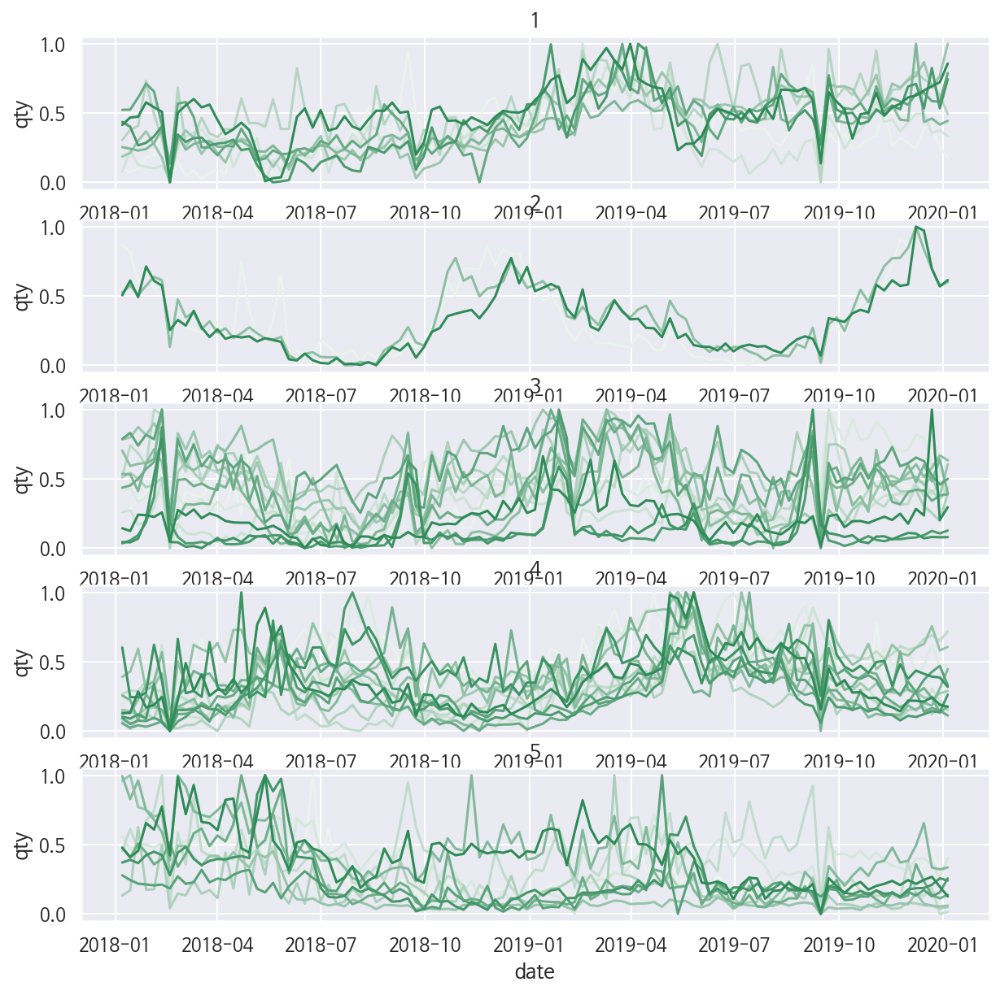

In [ ]:
# 위의 correlation 바탕 클러스터링을 통해 나뉘어진 5개의 군집 추이를 각각 시각화
import seaborn as sns

drink2 = pd.DataFrame(cluster_data.unstack()).reset_index()
drink2.columns = ['smcat','date','qty']
fig, ax =plt.subplots(5,1,figsize=(10,10))

for i in range(5):
    cluster_kind = list(cluster_ma[cluster_ma['그룹']==i+1]['업종'])
    temp_final = drink2[drink2['smcat'].isin(cluster_kind)].copy()
    sns.lineplot(x="date", y="qty", hue="smcat", data=temp_final, ax=ax[i], 
                 palette=sns.light_palette('seagreen', temp_final['smcat'].nunique()))
    ax[i].legend().set_visible(False)
    ax[i].set_title(i+1)

In [ ]:
# 3, 5번 클러스터 한번 더 재분류하기 위해 덴드로그램을 그려봅니다.
# 이번에는 correlation이 아닌 매출 값으로 나눕니다.
from scipy.cluster.hierarchy import dendrogram, linkage
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# 3번
cluster_kind = list(cluster_ma[cluster_ma['그룹']==3]['업종'])
cluster_3 = drink2[drink2['smcat'].isin(cluster_kind)].copy()
cluster_3 = cluster_3.pivot(index='date', columns='smcat', values='qty').reset_index().iloc[:,1:].transpose()
pdist = spc.distance.pdist(cluster_3)
linked = linkage(pdist, 'ward')
fig1 = ff.create_dendrogram(linked, color_threshold=20)

# 5번
cluster_kind = list(cluster_ma[cluster_ma['그룹']==5]['업종'])
cluster_5 = drink2[drink2['smcat'].isin(cluster_kind)].copy()
cluster_5 = cluster_5.pivot(index='date', columns='smcat', values='qty').reset_index().iloc[:,1:].transpose()
pdist = spc.distance.pdist(cluster_5)
linked = linkage(pdist, 'ward')
fig2 = ff.create_dendrogram(linked, color_threshold=8)


fig1.show()
fig2.show()

- 3번 군집은 2개로, 5번 군집은 3개로 다시 나누어줍니다

In [ ]:
# Agglomerative Clustering을 통해 추가 클러스터링
from sklearn.cluster import AgglomerativeClustering
# 3번 군집
cluster_price = AgglomerativeClustering(n_clusters=2, affinity='euclidean', linkage='ward')
cluster_3[0] = cluster_price.fit_predict(cluster_3)
df = pd.DataFrame(cluster_3[0]).reset_index()
df.columns = ['업종', '그룹']
df['그룹'] = df['그룹']+3

# 5번 군집
cluster_price = AgglomerativeClustering(n_clusters=3, affinity='euclidean', linkage='ward')
cluster_5[0] = cluster_price.fit_predict(cluster_5)
df1 = pd.DataFrame(cluster_5[0]).reset_index()
df1.columns = ['업종', '그룹']
df1['그룹'] = df1['그룹']+6

In [ ]:
# 클러스터 겹치지 않게 추가하기
cl3 = cluster_ma[cluster_ma['그룹']==3] # 3번 군집을 3, 4번으로 나누고
cl5 = cluster_ma[cluster_ma['그룹']==5] # 5번 군집을 6,7,8로 나눔
df2 = cluster_ma.drop(cl3.index)
df2 = df2.drop(cl5.index)
df2 = df2.replace(4,5)
df2 = pd.concat([df, df2]).reset_index()
cluster_ma2 = pd.concat([df1, df2]).reset_index()

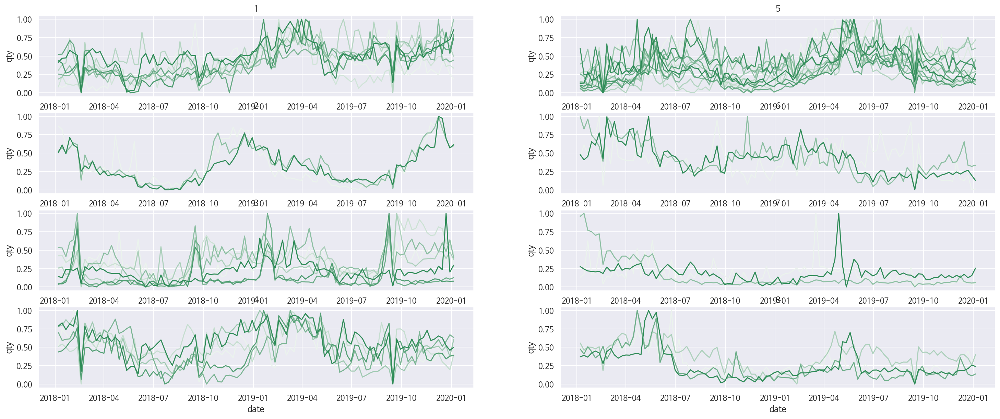

In [ ]:
# 여덟개의 군집을 다시 시각화 합니다
drink2 = pd.DataFrame(cluster_data.unstack()).reset_index()
drink2.columns = ['smcat','date','qty']
fig, ax =plt.subplots(4,2,figsize=(25,10))

for i in range(8):
    if i<4: num=0; j=i
    else: 
        num=1; j=i-4
    cluster_kind = list(cluster_ma2[cluster_ma2['그룹']==i+1]['업종'])
    temp_final = drink2[drink2['smcat'].isin(cluster_kind)].copy()
    sns.lineplot(x="date", y="qty", hue="smcat", data=temp_final, ax=ax[j,num], 
                 palette=sns.light_palette('seagreen', temp_final['smcat'].nunique()))
    ax[j,num].legend().set_visible(False)
    ax[j,num].set_title(i+1)

In [ ]:
# 군집별 품목 알아보기
cluster_ma2.groupby(['그룹','업종']).count()

level_0  index
그룹 업종                          
1  건강즙                 1      1
   보리차                 1      1
   옥수수차                1      1
   요거트/발효유             1      1
   원두커피                1      1
   저/무지방우유             1      1
   캡슐/POD커피            1      1
   흰우유                 1      1
2  유자차                 1      1
   율무차                 1      1
   코코아/핫초코             1      1
3  건강즙/녹용              1      1
   곡물차                 1      1
   과실차                 1      1
   배/포도/과일즙            1      1
   차 선물세트              1      1
   홍삼 음료               1      1
   홍차                  1      1
4  녹차                  1      1
   두유                  1      1
   둥굴레차                1      1
   딸기우유                1      1
   야채/호박즙              1      1
   인스턴트커피              1      1
5  과채 음료/주스            1      1
   기타 주스류              1      1
   더치커피                1      1
   밀크티/티라떼             1      1
   복분자/석류/과실즙          1      1
   생수                  1      1
   숙취/에너지/건강 음료        1      1
   식혜/수정과              1      1
   아몬드유/코코넛밀크          1      1
   아이스티                1      1
   어린이 음료              1      1
   이온음료                1      1
   차/곡물 음료             1      1
   탄산수                 1      1
6  양파/마늘즙              1      0
   전통차                 1      0
   허브차                 1      0
7  옻/칡/쑥즙              1      0
   유제품 음료              1      0
   커피음료                1      0
8  바나나우유               1      0
   비타민/화이바 음료          1      0
   초코우유                1      0
   탄산음료                1      0

## Multi Linear Regression

### 1) 회귀분석용 데이터 전처리

In [ ]:
# 주 단위로 묶어주기

from datetime import datetime
climate3['일자'] = pd.to_datetime(climate3['일자'])

climate_week = climate3.groupby('일자').mean()
climate_week = climate_week.resample('W', label='right').mean().reset_index() # 주 단위로 묶어주기

In [ ]:
climate_week = climate_week.set_index('일자')

In [ ]:
data = pd.read_csv("/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/clustering_model_data.csv", index_col='일자')

In [ ]:
data = data.iloc[:,0:8]

In [ ]:
# 날씨 변수 합쳐주기

new_model_data = data.join(climate_week, how='outer')

In [ ]:
new_model_data

,group1_mean,group2_mean,group3_mean,group4_mean,group5_mean,group6_mean,group7_mean,group8_mean,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),기온(°F),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
일자,,,,,,,,,,,,,,,,,,,,,,,,,
2018-01-07,0.286851,0.632576,0.239709,0.622720,0.200026,0.641595,0.456481,0.471694,-2.704167,-6.185714,1.685714,0.000000,27.128571,43.657143,-2.702857,38.285714,24.857143,0.011000,0.035571,0.714286,0.004857,0.310000,0.051619,1.524405,2.595238
2018-01-14,0.316581,0.668686,0.247429,0.660095,0.164070,0.615935,0.471006,0.420867,-5.069048,-8.214286,-1.514286,0.012500,22.857143,53.971429,-5.070000,41.142857,28.571429,0.014571,0.031429,0.628571,0.004143,0.307143,0.046571,1.995833,3.869048
2018-01-21,0.313553,0.529333,0.237620,0.650635,0.194888,0.628323,0.538206,0.464119,2.651786,-0.371429,6.514286,0.001190,36.785714,55.185714,2.651429,74.857143,53.142857,0.011571,0.049143,0.885714,0.005286,0.361429,0.056762,1.385119,4.886905
2018-01-28,0.401080,0.665002,0.314291,0.643016,0.205590,0.691200,0.378601,0.455667,-9.966071,-13.657143,-5.271429,0.019643,14.057143,38.400000,-9.965714,28.571429,17.142857,0.022714,0.022714,0.514286,0.003857,0.350000,0.062476,2.575000,2.136905
2018-02-04,0.359783,0.600132,0.425352,0.746487,0.246284,0.676816,0.361574,0.430173,-5.610714,-9.685714,-1.114286,0.020238,21.914286,47.828571,-5.612857,35.285714,21.428571,0.017143,0.030857,0.585714,0.004000,0.393810,0.061238,2.256548,1.964286
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-08,0.660190,1.000000,0.381489,0.511155,0.304902,0.283074,0.119006,0.307637,-1.539881,-5.757143,2.728571,0.004167,29.214286,49.900000,-1.540000,32.857143,23.000000,0.011286,0.032571,0.771429,0.004714,0.347095,0.059190,2.105952,2.297619
2019-12-15,0.596752,0.872449,0.385115,0.448354,0.317150,0.342633,0.101779,0.292812,3.788690,-0.300000,7.900000,0.017262,38.814286,58.542857,3.790000,52.285714,41.000000,0.009286,0.038286,0.957143,0.005571,0.394286,0.052048,2.094643,5.101190
2019-12-22,0.590708,0.697271,0.429651,0.438406,0.346469,0.264811,0.081057,0.286309,2.444048,-1.314286,6.185714,0.061905,36.385714,60.914286,2.445714,36.285714,27.285714,0.008714,0.035714,0.842857,0.005286,0.297381,0.044714,2.109524,4.958333


### 2) 다중공선성 확인

In [ ]:
climate_corr = climate.drop(['일자'], axis = 1)

In [ ]:
sb.set(font="NanumGothic", 
        rc={"axes.unicode_minus":False})

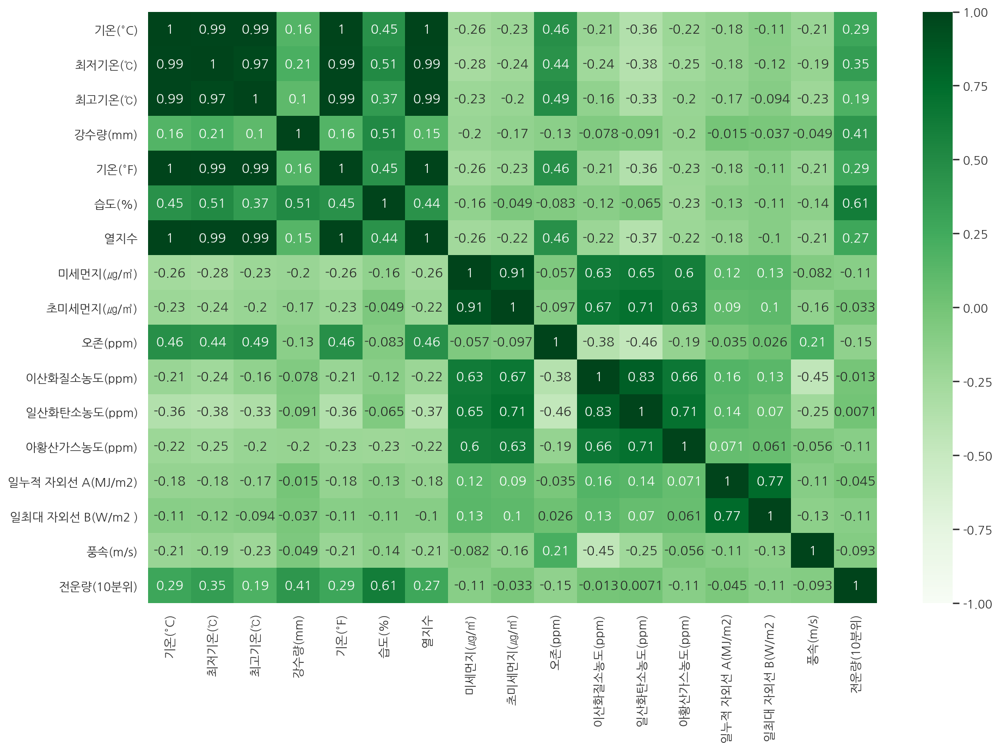

In [ ]:
plt.rcParams['figure.figsize']=(15,10)
sb.heatmap(climate_corr.corr(),
          annot=True,
          cmap='Greens',
          vmin = -1, vmax = 1
          )

### 3) VIF 큰 변수 제거

회귀 모델에서 다중공선성을 파악할 수 있는 대표적인 방법은 VIF

VIF (Variance inflation Factors 분산팽창요인)

안전 : VIF < 5

주의 : 5 < VIF < 10

위험 : 10 < VIF

In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
# 피처마다의 VIF 계수를 출력합니다.
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(climate_corr.values, i) for i in range(climate_corr.shape[1])]
vif["features"] = climate_corr.columns
vif

,VIF Factor,features
0,1530.614249,기온(°C)
1,269.836333,최저기온(℃)
2,650.977161,최고기온(℃)
3,1.638691,강수량(mm)
4,465.664610,기온(°F)
5,44.454050,습도(%)
6,455.463830,열지수
7,28.883551,미세먼지(㎍/㎥)
8,28.416498,초미세먼지(㎍/㎥)
9,11.043164,오존(ppm)


In [ ]:
climate_corr=climate_corr.drop(['최저기온(℃)','최고기온(℃)', '기온(°F)', '습도(%)', '열지수','초미세먼지(㎍/㎥)', '오존(ppm)', '이산화질소농도(ppm)', '일산화탄소농도(ppm)', '아황산가스농도(ppm)', '일최대 자외선 B(W/m2 )'], axis=1)
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(climate_corr.values, i) for i in range(climate_corr.shape[1])]
vif["features"] = climate_corr.columns
vif

,VIF Factor,features
0,2.529104,기온(°C)
1,1.349058,강수량(mm)
2,3.217015,미세먼지(㎍/㎥)
3,1.132526,일누적 자외선 A(MJ/m2)
4,4.306726,풍속(m/s)
5,4.076248,전운량(10분위)


In [ ]:
# VIF 높은 변수들은 drop
climate_week2 = climate_week.drop(['최저기온(℃)','최고기온(℃)', '기온(°F)', '습도(%)', '열지수','초미세먼지(㎍/㎥)','오존(ppm)',
                                   '이산화질소농도(ppm)', '일산화탄소농도(ppm)', '아황산가스농도(ppm)', '일최대 자외선 B(W/m2 )'], axis=1)

In [ ]:
new_model_data2 = data.join(climate_week2, how='outer')

### 4) 최종 데이터셋으로 군집별 회귀

In [ ]:
new_model_data2.rename(columns = {'기온(°C)':'temp', '강수량(mm)':'rain', '미세먼지(㎍/㎥)':'dust', '일누적 자외선 A(MJ/m2)': 'UV_A','풍속(m/s)': 'wind', '전운량(10분위)':'cloud'}, inplace = True)

In [ ]:
df = new_model_data2

In [ ]:
# 로그 씌워주기
df['logtemp']=np.log(df['temp']+10)
df['lograin']=np.log(df['rain']*100 +0.01)
df['logdust']=np.log(df['dust'])
df['logUV_A']=np.log(df['UV_A']*10 + 0.01)
df['logwind']=df['wind']
df['logcloud']=np.log(df['cloud'])

# 회귀분석 함수 만들어주기
def regression(group, type):
  if type == 'reg':
      model = smf.ols(formula = group +' ~ temp + rain + dust + UV_A + wind + cloud', data = df)
  if type == 'log':
      model = smf.ols(formula = group +' ~ logtemp + lograin + logdust + logUV_A + logwind + logcloud', data = df)
  result = model.fit()
  result.summary()
  return result.summary()

In [ ]:
data1 = new_model_data2.drop(['group2_mean', 'group3_mean', 'group4_mean', 'group5_mean', 'group6_mean', 'group7_mean', 'group8_mean'], axis=1)

In [ ]:
print(regression('group1_mean','reg'))

                            OLS Regression Results                            
Dep. Variable:            group1_mean   R-squared:                       0.223
Model:                            OLS   Adj. R-squared:                  0.176
Method:                 Least Squares   F-statistic:                     4.698
Date:                Sun, 27 Jun 2021   Prob (F-statistic):           0.000305
Time:                        08:49:03   Log-Likelihood:                 55.143
No. Observations:                 105   AIC:                            -96.29
Df Residuals:                      98   BIC:                            -77.71
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.0199      0.116      0.171      0.8

- 바람, 미세먼지, 구름: +
- 비: -

In [ ]:
print(regression('group2_mean', 'reg'))

                            OLS Regression Results                            
Dep. Variable:            group2_mean   R-squared:                       0.649
Model:                            OLS   Adj. R-squared:                  0.628
Method:                 Least Squares   F-statistic:                     30.26
Date:                Sun, 27 Jun 2021   Prob (F-statistic):           2.71e-20
Time:                        08:49:03   Log-Likelihood:                 60.284
No. Observations:                 105   AIC:                            -106.6
Df Residuals:                      98   BIC:                            -87.99
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.7143      0.111      6.440      0.0

- 기온: -

In [ ]:
print(regression('group3_mean', 'reg'))

                            OLS Regression Results                            
Dep. Variable:            group3_mean   R-squared:                       0.298
Model:                            OLS   Adj. R-squared:                  0.255
Method:                 Least Squares   F-statistic:                     6.946
Date:                Sun, 27 Jun 2021   Prob (F-statistic):           3.59e-06
Time:                        08:49:03   Log-Likelihood:                 86.248
No. Observations:                 105   AIC:                            -158.5
Df Residuals:                      98   BIC:                            -139.9
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.1937      0.087      2.236      0.0

- 구름: +
- 기온, 자외선: -

In [ ]:
print(regression('group4_mean','reg'))

                            OLS Regression Results                            
Dep. Variable:            group4_mean   R-squared:                       0.437
Model:                            OLS   Adj. R-squared:                  0.403
Method:                 Least Squares   F-statistic:                     12.70
Date:                Sun, 27 Jun 2021   Prob (F-statistic):           1.47e-10
Time:                        08:49:03   Log-Likelihood:                 67.164
No. Observations:                 105   AIC:                            -120.3
Df Residuals:                      98   BIC:                            -101.8
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.3075      0.104      2.960      0.0

- 미세먼지: +
- 기온: -

In [ ]:
print(regression('group5_mean','reg'))

                            OLS Regression Results                            
Dep. Variable:            group5_mean   R-squared:                       0.478
Model:                            OLS   Adj. R-squared:                  0.446
Method:                 Least Squares   F-statistic:                     14.94
Date:                Sun, 27 Jun 2021   Prob (F-statistic):           4.58e-12
Time:                        08:49:03   Log-Likelihood:                 95.123
No. Observations:                 105   AIC:                            -176.2
Df Residuals:                      98   BIC:                            -157.7
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.0850      0.080     -1.068      0.2

- 기온, 미세먼지, 바람: +

In [ ]:
print(regression('group6_mean','reg'))

                            OLS Regression Results                            
Dep. Variable:            group6_mean   R-squared:                       0.219
Model:                            OLS   Adj. R-squared:                  0.172
Method:                 Least Squares   F-statistic:                     4.590
Date:                Sun, 27 Jun 2021   Prob (F-statistic):           0.000380
Time:                        08:49:03   Log-Likelihood:                 57.923
No. Observations:                 105   AIC:                            -101.8
Df Residuals:                      98   BIC:                            -83.27
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.5542      0.113      4.885      0.0

- 기온: -

In [ ]:
print(regression('group7_mean','reg'))

                            OLS Regression Results                            
Dep. Variable:            group7_mean   R-squared:                       0.082
Model:                            OLS   Adj. R-squared:                  0.025
Method:                 Least Squares   F-statistic:                     1.451
Date:                Sun, 27 Jun 2021   Prob (F-statistic):              0.203
Time:                        08:49:03   Log-Likelihood:                 87.567
No. Observations:                 105   AIC:                            -161.1
Df Residuals:                      98   BIC:                            -142.6
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.1567      0.086      1.832      0.0

- 모두 유의하지 않음

In [ ]:
print(regression('group8_mean','reg'))

                            OLS Regression Results                            
Dep. Variable:            group8_mean   R-squared:                       0.106
Model:                            OLS   Adj. R-squared:                  0.051
Method:                 Least Squares   F-statistic:                     1.939
Date:                Sun, 27 Jun 2021   Prob (F-statistic):             0.0820
Time:                        08:49:03   Log-Likelihood:                 48.851
No. Observations:                 105   AIC:                            -83.70
Df Residuals:                      98   BIC:                            -65.12
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.1646      0.124      1.331      0.1

- 강수량, 미세먼지: +
- 구름: -

# 3. NLP

## 크롤링 데이터 전처리

In [ ]:
# 크롤링 한 데이터 가져오기
crawling = pd.read_csv("/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/크롤링/crawling.csv")

In [ ]:
# 한국어 nlp 처리 패키지 Konlpy 설치
!pip install konlpy

### 1) 불용어 및 데이터 정제

In [ ]:
from konlpy.tag import Okt
from tensorflow.keras.preprocessing.text import Tokenizer

# 불용어 설정
stopwords = ['않다','에서','있다','없다','그렇다','아니다','것','이다','의','가','이','은','들', '주',
             '는','좀','잘','걍','과','도','을','를','으로','자','에','와','한','하다','휴','수' ,'일']

df = crawling

# 불순어 제거
df['text'] = df['text'].str.replace("[^ㄱ-ㅎㅏ-ㅣ가-힣 ]","")
df['text'].replace('', np.nan, inplace=True)

### 2) 토크나이징 후 명사만 추출: 시간 좀 오래걸려용

In [ ]:
#konlpy로 명사만 추출하는 토큰화를 진행
okt = Okt()
token = []
for sentence in df['text']:
    temp_X = []
    temp_X = okt.nouns(sentence) # 명사 토큰화
    temp_X = [word for word in temp_X if not word in stopwords] # 불용어 제거
    token.append(temp_X)
df['token'] = token
tokenizer = Tokenizer()
tokenizer.fit_on_texts(token)

## 워드 클라우드

### 1) 다류 종류 별 워드클라우드 생성

In [ ]:
from collections import Counter 
# 단어 빈도 수 세어서 가장 빈도 높은 300개만 추출하는 함수 정의
def tokenizing(df):
    words = np.hstack(df['token'].values)
    word_count = Counter(words)
    input = dict(word_count.most_common(300))
    return input

In [ ]:
from wordcloud import WordCloud
# 토크나이징된 data frame 넣으면 워드클라우드 그려주는 함수 정의
def wcdraw(df, color):  
  df2 = tokenizing(df)
  fontpath = '/usr/share/fonts/truetype/nanum/NanumSquareB.ttf'
  wordcloud = WordCloud(font_path = fontpath, max_words=100, colormap = color,
                      width=900,height=500, background_color ='white')
  wordcloud = wordcloud.generate_from_frequencies(df2)
  plt.figure(figsize = (15 , 10))
  plt.axis("off")
  plt.imshow(wordcloud)

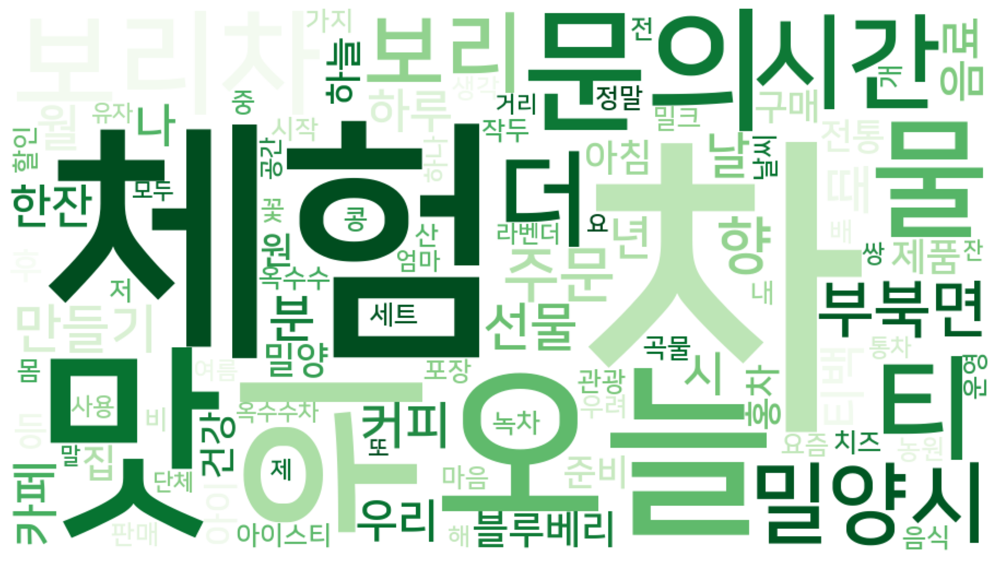

In [ ]:
wcdraw(df, 'Greens')

- 전체적으로는 인스타라서 그런지 뭔가 홍보하는 듯한 체험, 만들기 등의 말이 많이 보임 

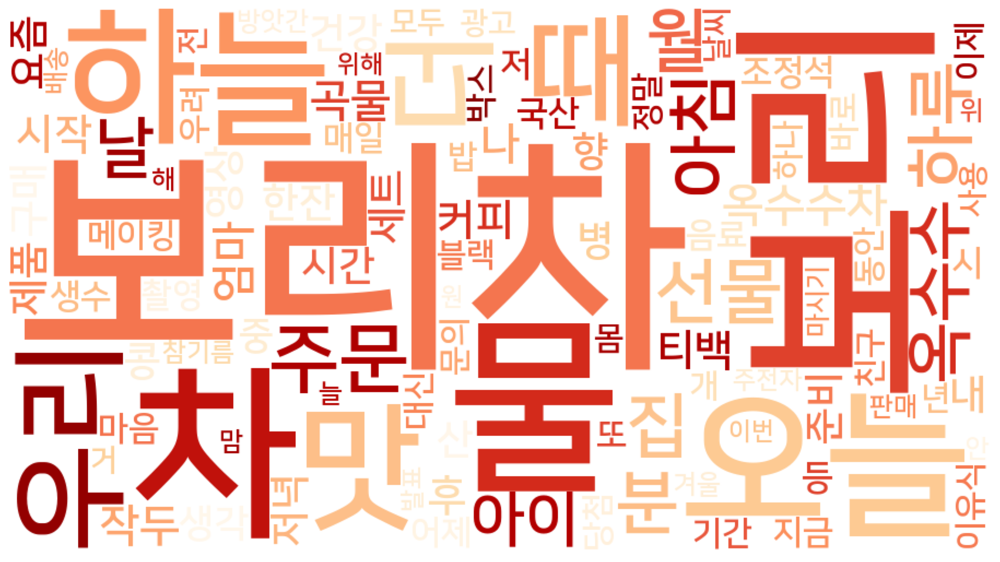

In [ ]:
df_cluster = df[df['category'] == 'bori']
wcdraw(df_cluster, 'OrRd')

- 보리차인데 옥수수차가 같이 보임!! -> 클러스터링 결과와도 일맥상통
- 물, 아침, 매일 이런 단어를 통해서 뭔가 진짜 물 대용이라는거 파악 가능

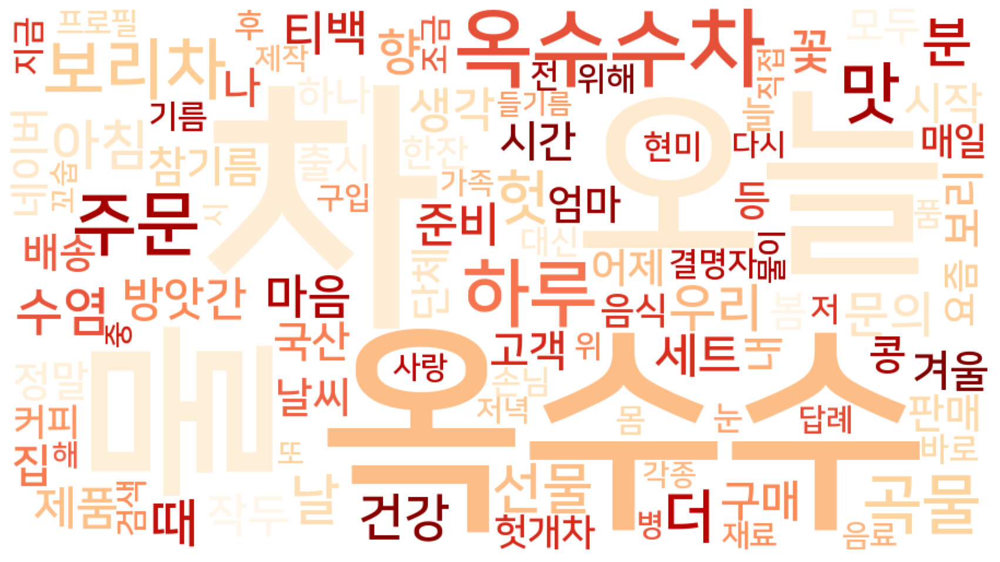

In [ ]:
df_cluster = df[df['category'] == 'corn']
wcdraw(df_cluster, 'OrRd')

- 얘도 보리차가 같이 보임
- 물

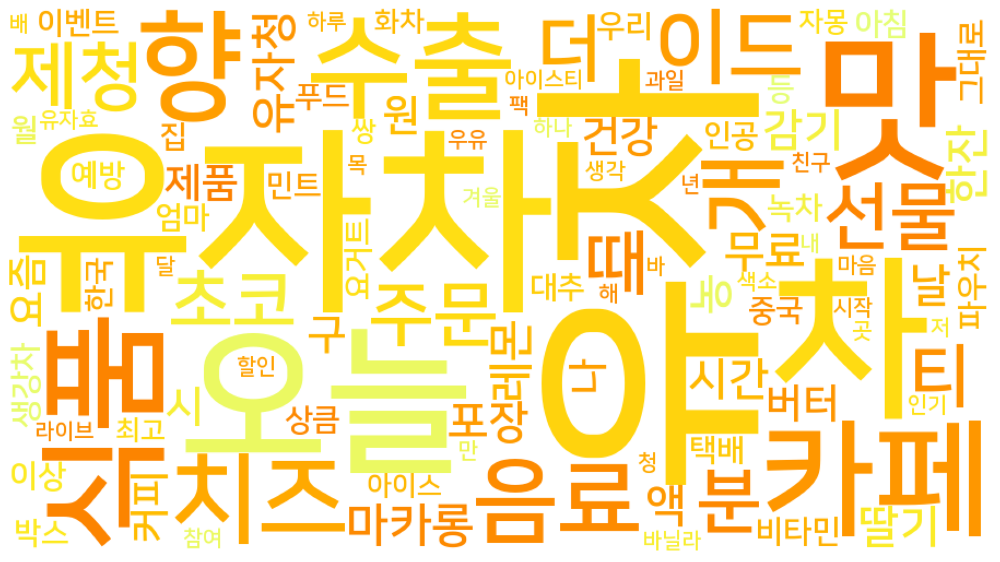

In [ ]:
df_cluster = df[df['category'] == 'yuja']
wcdraw(df_cluster, 'Wistia')

- 유자차와 함께 카페, 맛에 대한 이야기가 많음

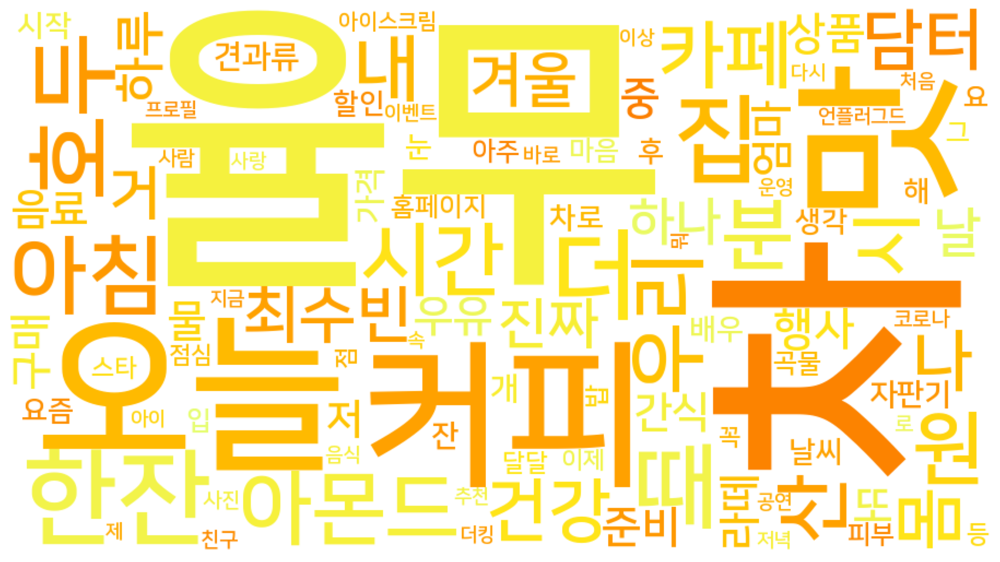

In [ ]:
df_cluster = df[df['category'] == 'yulmu']
wcdraw(df_cluster, 'Wistia')

- 아몬드, 호두 등 견과류와의 관계가 높음
- 커피와의 관계가 높다는 것도 눈여겨볼만 함

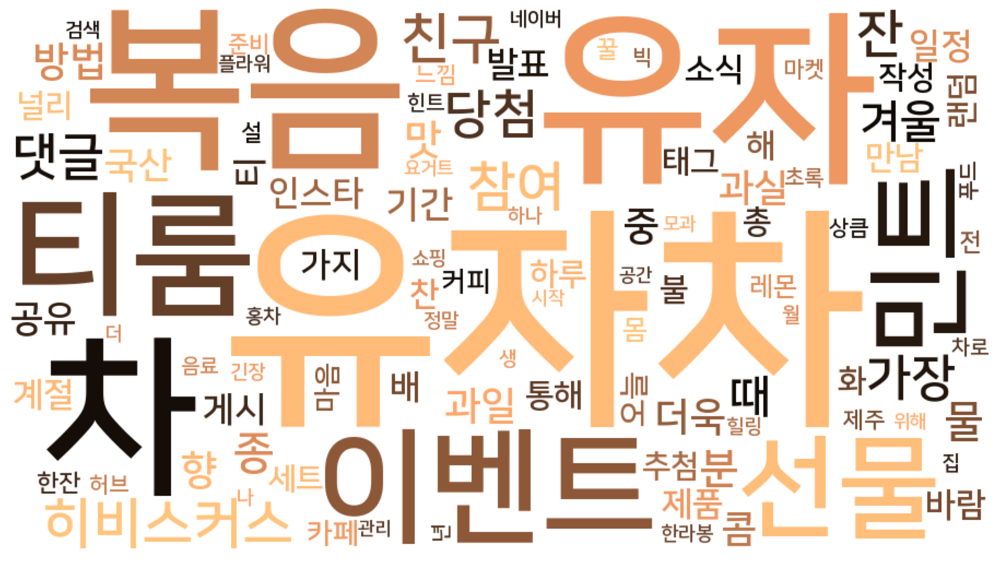

In [ ]:
df_cluster = df[df['category'] == 'fruit']
wcdraw(df_cluster, 'copper')

- 민트, 히비스커스 차, 유자차가 가장 큰 과실차로 분류 -> 유자차와 구분해야 할듯?
- 복음자리 브랜드가 trending 하는듯
- 티룸이라는 문구가 눈여겨볼만 함 -> 조금 더 고급화

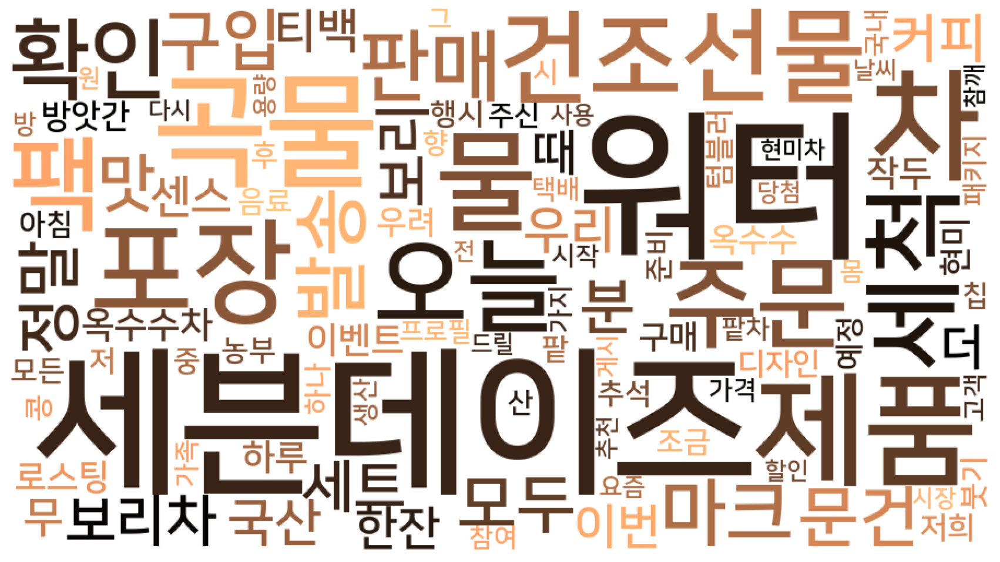

In [ ]:
df_cluster = df[df['category'] == 'gok']
wcdraw(df_cluster, 'copper')

- 다이어트 용 미수 곡물차워터 세븐데이즈 브랜드가 가장 많이 뽑힌듯한 느낌

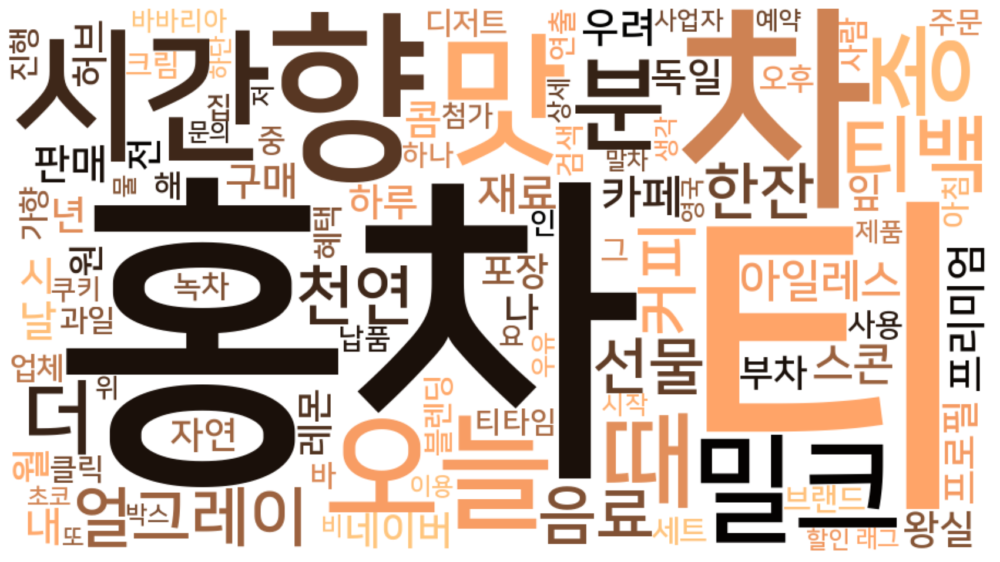

In [ ]:
df_cluster = df[df['category'] == 'red']
wcdraw(df_cluster, 'copper')

- 뭔가 '티' 처럼 조금 더 서양화된 차의 이미지를 볼 수 있음
- 왕실, 밀크, 향, 맛 등 확실히 맛을 조금 더 추구하는 듯함

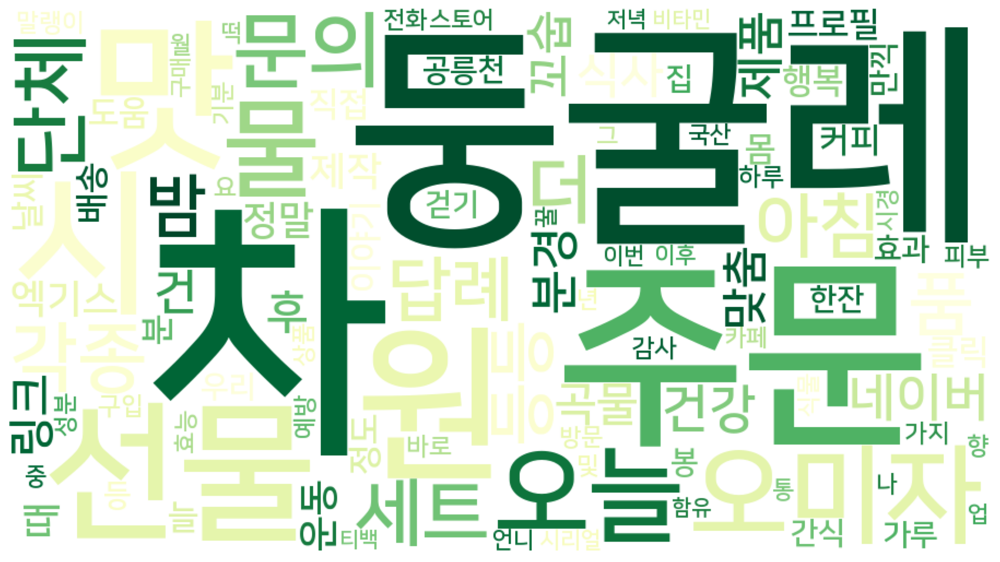

In [ ]:
df_cluster = df[df['category'] == 'dungul']
wcdraw(df_cluster, 'YlGn')

- 인스타만 들어가서 아직 주문만 있음
- 단체, 차 선물 등으로 인해 클러스터 1보다는 좀 더 물 대용은 아니라는거를 볼 수 있음

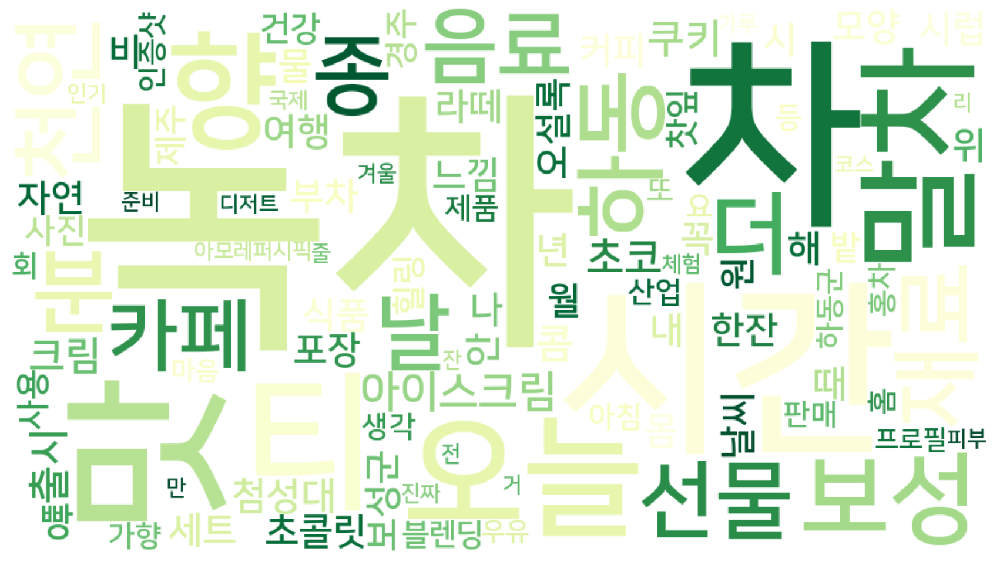

In [ ]:
df_cluster = df[df['category'] == 'green']
wcdraw(df_cluster, 'YlGn')

- 말차, 크림, 아이스크림 등 확실히 녹차 자체보다는 '녹차(말차)맛' 식품에 대한 기호 확인 가능
- 녹차 향에 대한 이야기도 눈여겨볼만 함

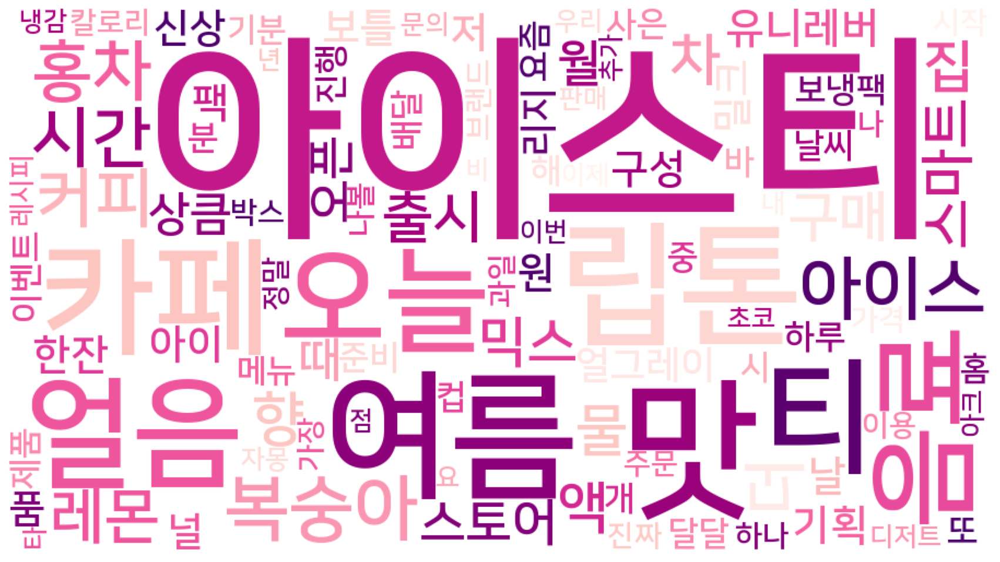

In [ ]:
df_cluster = df[df['category'] == 'ice']
wcdraw(df_cluster, 'RdPu')

- 홍차, 복숭아, 레몬, 립톤 등 확인 가능
- 계절적인 요소인 여름이 처음으로 나옴 -> 확실히 여름에 수요가 급증

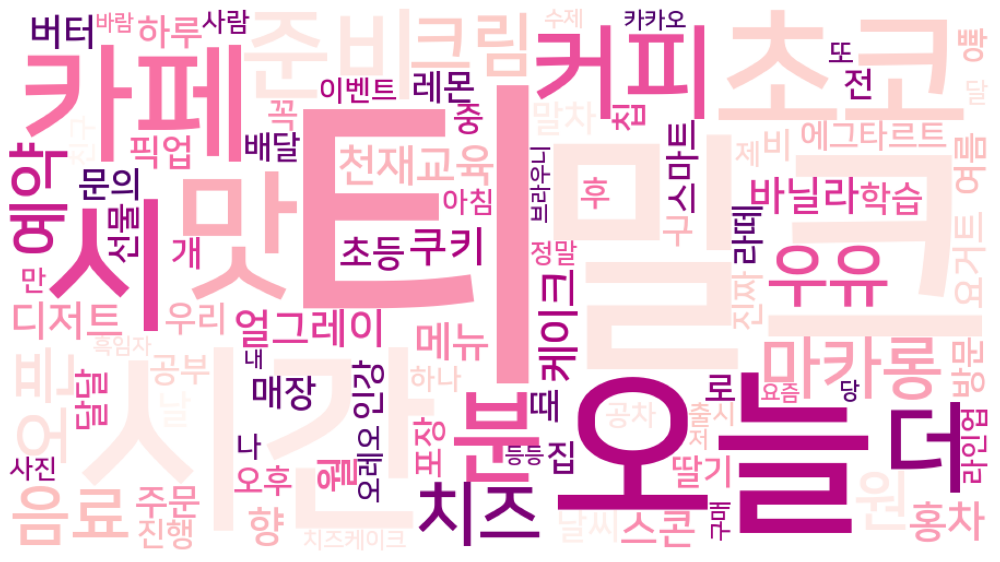

In [ ]:
df_cluster = df[df['category'] == 'milk']
wcdraw(df_cluster, 'RdPu')

- 바닐라, 쿠키, 케이크, 초코, 디저트 등 앞의 차들 보다는 조금더 대중화되고 디저트화 된듯한 이미지

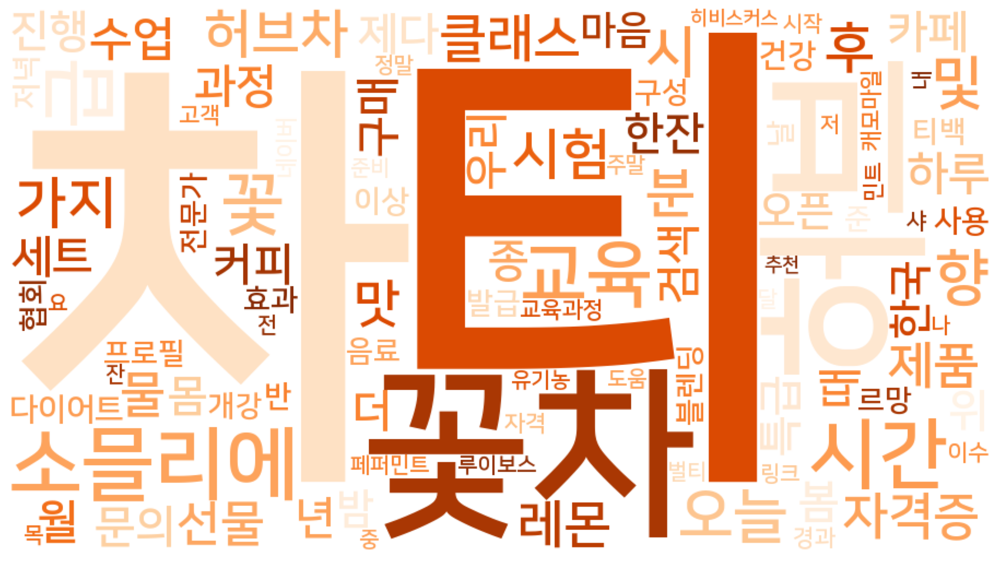

In [ ]:
df_cluster = df[df['category'] == 'herb']
wcdraw(df_cluster, 'Oranges')

- 꽃차와 티 소믈리에에 관한 이야기 확인 가능
- 시험에 많이 출제되는 듯함

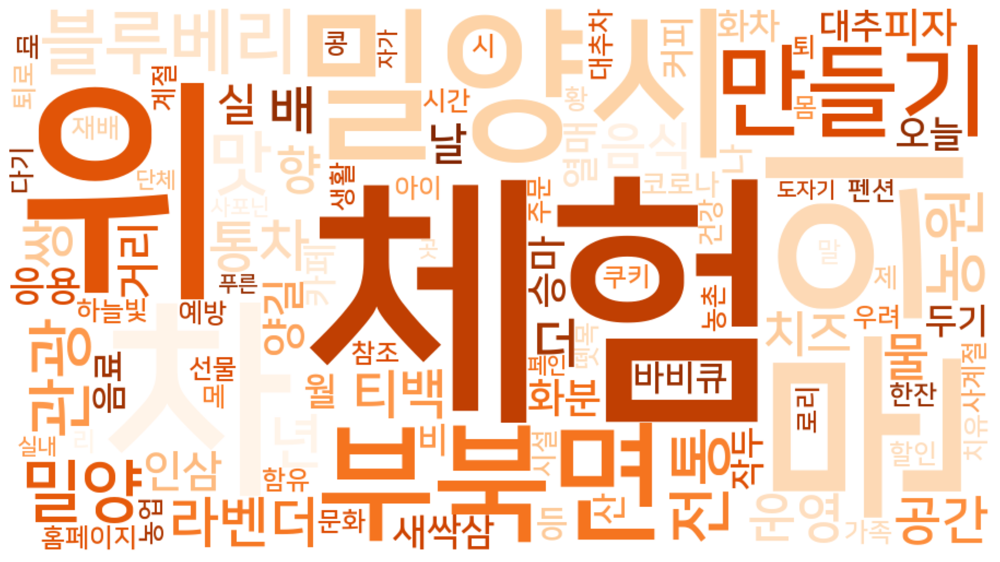

In [ ]:
df_cluster = df[df['category'] == 'trad']
wcdraw(df_cluster, 'Oranges')

- 전통차는 확실히 맛보다는 체험적으로, 공감각적인 요소가 두드러지는 마케팅 포인트임

### 2) 클러스터 별 워드클라우드 생성

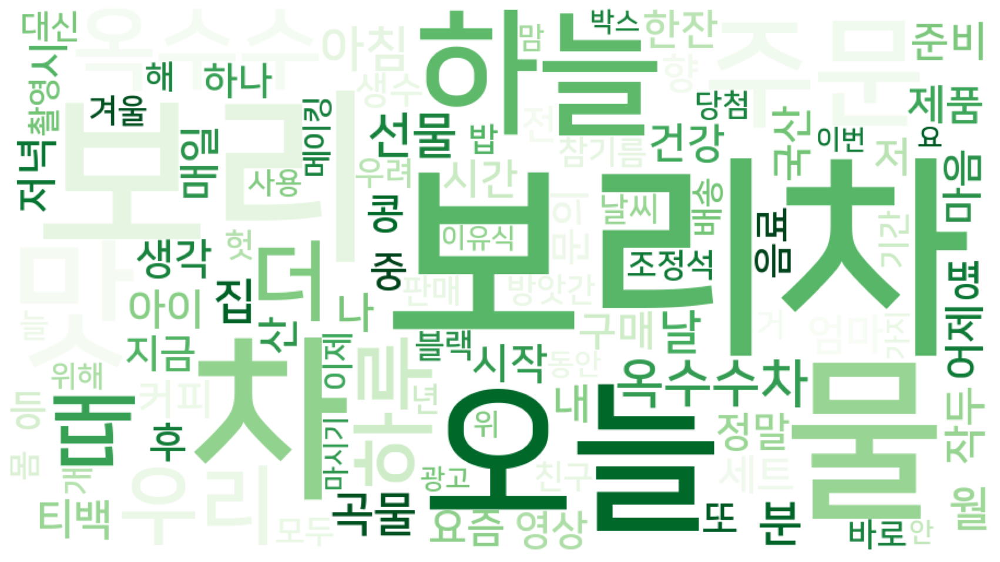

In [ ]:
# cluster 1 - 보리차, 옥수수차
newdf = df[df['category'].isin(['bori','corn'])]
wcdraw(newdf, 'Greens')

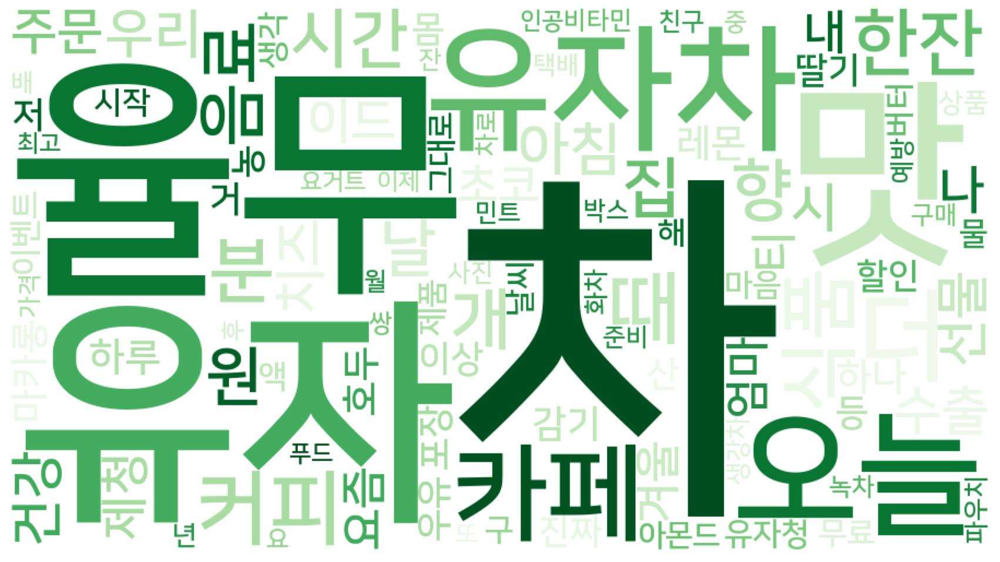

In [ ]:
# cluster 2 - 유자차, 율무차
newdf = df[df['category'].isin(['yuja','yulmu'])]
wcdraw(newdf, 'Greens')

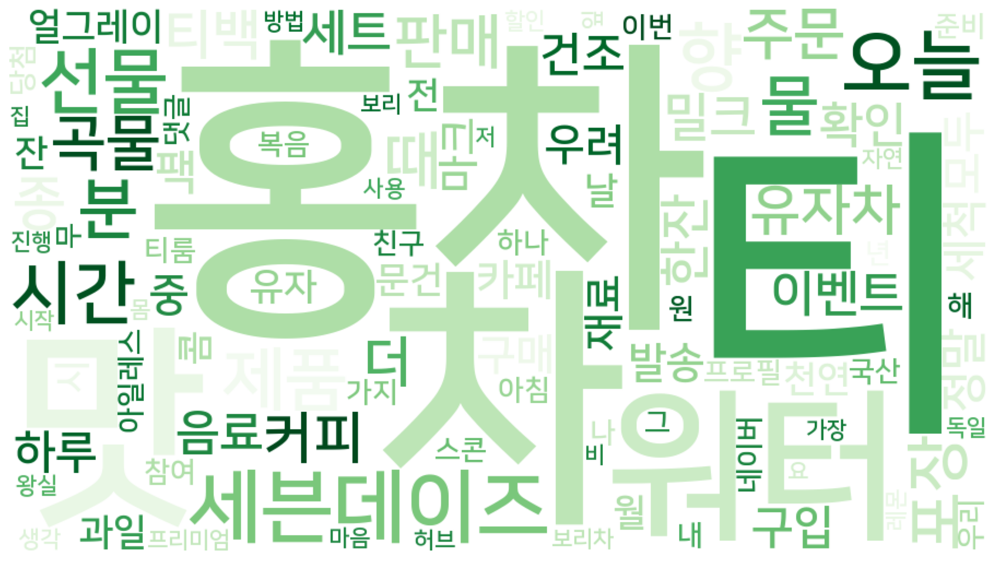

In [ ]:
# cluster 3 - 곡물차, 과실차, 홍차
newdf = df[df['category'].isin(['gok','fruit','red'])]
wcdraw(newdf, 'Greens')

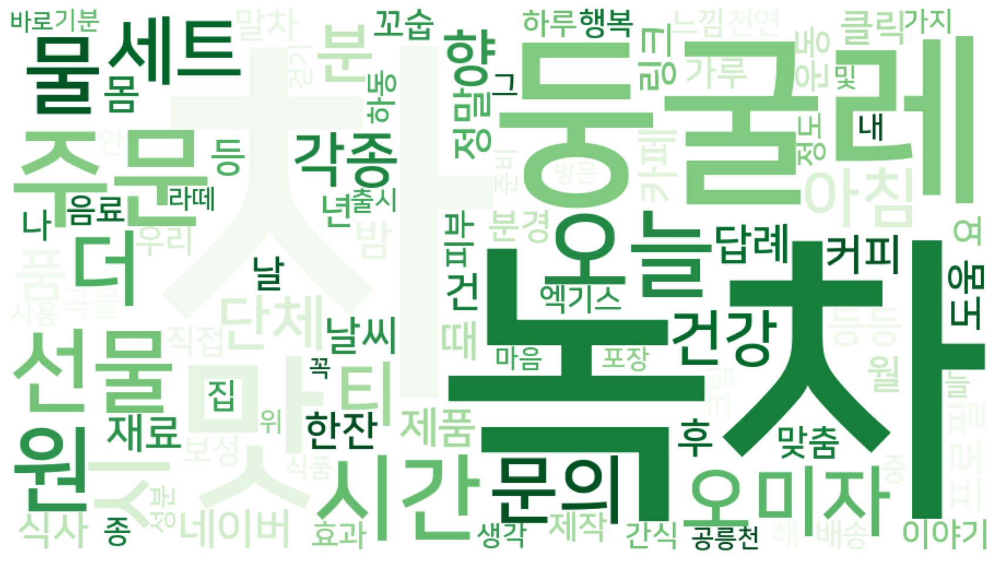

In [ ]:
# cluster 4 - 녹차, 둥굴레차
newdf = df[df['category'].isin(['green','dungul'])]
wcdraw(newdf, 'Greens')

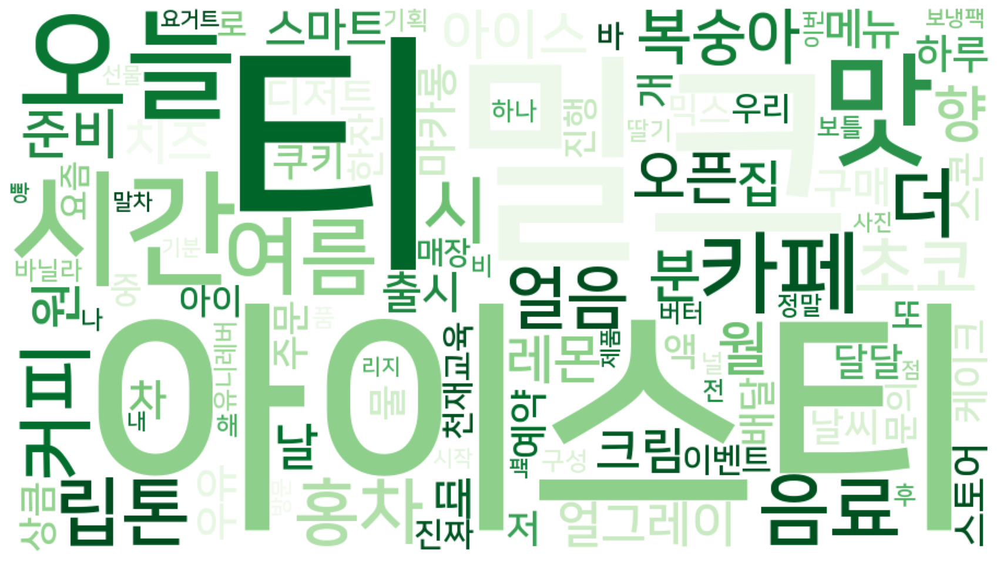

In [ ]:
# cluster 5 - 밀크티, 아이스티
newdf = df[df['category'].isin(['ice','milk'])]
wcdraw(newdf, 'Greens')

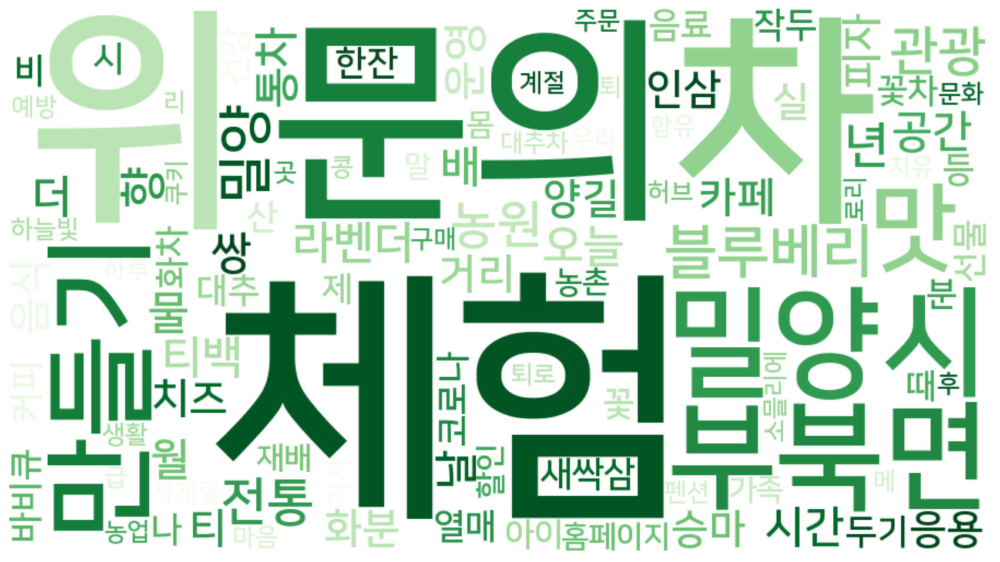

In [ ]:
# cluster 6 - 전통차, 허브티
newdf = df[df['category'].isin(['trad','herb'])]
wcdraw(newdf, 'Greens')

## 감성분석

### 1) 감성분석 LSTM 모델 학습

In [ ]:
# 계절 별로 나누기 위해 날짜에서 월만 추출
df['date'] = pd.to_datetime(df['date'], utc=True)
df['month'] = pd.DatetimeIndex(df['date']).month

In [ ]:
try:
    # %tensorflow_version only exists in Colab.
    %tensorflow_version 2.x
except Exception:
    pass
import tensorflow as tf
import numpy as np
import pandas as pd

In [ ]:
# 감성분석용 테스트 파일 다운로드
path_to_train_file = tf.keras.utils.get_file('train.txt', 'https://raw.githubusercontent.com/e9t/nsmc/master/ratings_train.txt')
path_to_test_file = tf.keras.utils.get_file('test.txt', 'https://raw.githubusercontent.com/e9t/nsmc/master/ratings_test.txt')

4898816/4893335 [==============================] - 0s 0us/step


In [ ]:
# train-test 데이터셋 분리
train_text = open(path_to_train_file, 'rb').read().decode(encoding='utf-8')
test_text = open(path_to_test_file, 'rb').read().decode(encoding='utf-8')

train_Y = np.array([[int(row.split('\t')[2])] for row in train_text.split('\n')[1:] if row.count('\t') > 0])
test_Y = np.array([[int(row.split('\t')[2])] for row in test_text.split('\n')[1:] if row.count('\t') > 0])

In [ ]:
# 훈련 데이터 정제
import re
# From https://github.com/yoonkim/CNN_sentence/blob/master/process_data.py

def clean_str(string):    
    string = re.sub(r"[^가-힣A-Za-z0-9(),!?\'\`]", " ", string)
    string = re.sub(r"\'s", " \'s", string)
    string = re.sub(r"\'ve", " \'ve", string)
    string = re.sub(r"n\'t", " n\'t", string)
    string = re.sub(r"\'re", " \'re", string)
    string = re.sub(r"\'d", " \'d", string)
    string = re.sub(r"\'ll", " \'ll", string)
    string = re.sub(r",", " , ", string)
    string = re.sub(r"!", " ! ", string)
    string = re.sub(r"\(", " \( ", string)
    string = re.sub(r"\)", " \) ", string)
    string = re.sub(r"\?", " \? ", string)
    string = re.sub(r"\s{2,}", " ", string)
    string = re.sub(r"\'{2,}", "\'", string)
    string = re.sub(r"\'", "", string)

    return string.lower()

train_text_X = [row.split('\t')[1] for row in train_text.split('\n')[1:] if row.count('\t') > 0]
train_text_X = [clean_str(sentence) for sentence in train_text_X]

# 문장을 띄어쓰기 단위로 단어 분리
sentences = [sentence.split(' ') for sentence in train_text_X]

# 문장 전처리
sentence_new = []
for sentence in sentences:
  sentence_new.append([word[:5] for word in sentence][:25])

sentences = sentence_new

In [ ]:
# 토크나이징
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

tokenizer = Tokenizer(num_words=2000)
tokenizer.fit_on_texts(sentences)
train_X = tokenizer.texts_to_sequences(sentences)
train_X = pad_sequences(train_X, padding='post')

In [ ]:
# LSTM 감성분석 모델 학습
model = tf.keras.Sequential([
  tf.keras.layers.Embedding(20000, 300, input_length=25), 
  tf.keras.layers.LSTM(units=50), 
  tf.keras.layers.Dense(2, activation='softmax')
])

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 25, 300)           6000000   
_________________________________________________________________
lstm (LSTM)                  (None, 50)                70200     
_________________________________________________________________
dense (Dense)                (None, 2)                 102       
Total params: 6,070,302
Trainable params: 6,070,302
Non-trainable params: 0
_________________________________________________________________


In [ ]:
history = model.fit(train_X, train_Y, epochs=5, batch_size=128, validation_split=0.2)

Epoch 1/5
938/938 [==============================] - 110s 114ms/step - loss: 0.4958 - accuracy: 0.7343 - val_loss: 0.4547 - val_accuracy: 0.7683
Epoch 2/5
938/938 [==============================] - 105s 112ms/step - loss: 0.4477 - accuracy: 0.7643 - val_loss: 0.4583 - val_accuracy: 0.7690
Epoch 3/5
938/938 [==============================] - 105s 112ms/step - loss: 0.4371 - accuracy: 0.7698 - val_loss: 0.4471 - val_accuracy: 0.7707
Epoch 4/5
938/938 [==============================] - 106s 112ms/step - loss: 0.4286 - accuracy: 0.7735 - val_loss: 0.4477 - val_accuracy: 0.7698
Epoch 5/5
938/938 [==============================] - 104s 111ms/step - loss: 0.4197 - accuracy: 0.7786 - val_loss: 0.4575 - val_accuracy: 0.7655


### 2) 감성분석 결과 시각화

In [ ]:
# 모델을 통해 크롤링한 데이터에 감성분석 시행
test_sentences = df['token'].tolist()
test_X_1 = tokenizer.texts_to_sequences(test_sentences)
test_X_1 = pad_sequences(test_X_1, padding='post', maxlen=25)
prediction = model.predict(test_X_1)
score= []
for idx, sentence in enumerate(test_sentences):
  score.append(prediction[idx][1])

In [ ]:
len(score)

23724

In [ ]:
# 감성분석 결과 column으로 추가
df = df.assign(score = score)

In [ ]:
df.groupby(['category', 'month']).mean()

Unnamed: 0  Unnamed: 0.1     score
category month                                      
bori     1       4970.300937   4970.300937  0.452861
         2       4460.660061   4460.660061  0.473134
         3       3417.718153   3417.718153  0.470213
         4       3709.072581   3709.072581  0.486698
         5       3870.078873   3870.078873  0.523788
...                      ...           ...       ...
yulmu    8      23510.887324  23510.887324  0.408420
         9      22957.210526  22957.210526  0.397801
         10     22798.646552  22798.646552  0.412983
         11     22860.493243  22860.493243  0.408278
         12     23049.732955  23049.732955  0.415449

[154 rows x 3 columns]

In [ ]:
df['category'].unique().tolist()

['bori',
 'corn',
 'dungul',
 'fruit',
 'gok',
 'green',
 'herb',
 'ice',
 'milk',
 'red',
 'trad',
 'yuja',
 'yulmu']

In [ ]:
#품목 별 긍정반응 분석
cat = df['category'].unique().tolist()
dfs = ['d1','d2','d3','d4','d5','d6','d7','d8','d9','d10','d11','d12','d13']
trace = []

for i,j in zip(cat,list(range(0,14))):
  dfs[j] = df.loc[df['category'] == i].groupby(by=['month']).mean().reset_index()

for i,j in zip(cat,list(range(0,14))):
  trace.append(go.Bar(x=dfs[j].month, y=dfs[j].score, name=i))
fig = go.Figure(data=trace, layout=go.Layout(title='품목 별 긍정반응 분석'))
fig.update_layout(template="plotly_white")
pyo.iplot(fig)

# 4. Modeling

## 1. 데이터 전처리 추가 진행

### 1) 모델링 위한 음료 데이터 전처리

In [ ]:
# 차가 포함된 음료 데이터 불러오기
data_drink = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/model_drink_data.csv',index_col=0)
data_drink.head()
data_drink_columns = data_drink.columns.to_list()

In [ ]:
# 연령 변수 이진변수로 묶어주기
data_drink['age'] = data_drink['age'].replace([20,30],'청년층')
data_drink['age'] = data_drink['age'].replace([40,50,60],'중장년층')

In [ ]:
## 가변수 하나 제거하기
data_drink = pd.get_dummies(data_drink, columns = ['sex','age'],drop_first=True)

### 2) 날씨데이터도 모델링 위해 수정

In [ ]:
data_climate = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/날씨 데이터/climate3.csv', index_col=0)
data_climate = data_climate.reset_index()
data_climate['일자'] = pd.to_datetime(data_climate['일자'], format='%Y-%m-%d')

data_climate = data_climate.set_index('일자') # 날씨 index.
data_climate = data_climate.drop('기온(°F)',axis=1) # 화씨 온도는 섭씨 온도와 중복이므로? 제거. 추후 더 제거 가능..

data_climate_columns = data_climate.columns.to_list() # column 이름 추출

### 3) Cluster 6 선택

In [ ]:
# data_drink에서 해당 음료/차 뽑고
# 판매량 전체 sum. 
data_drink = data_drink.groupby(["date","sex_M", "age_청년층"],as_index=True).sum() 

# data_cluster_qty = data_drink[['건강즙', '보리차', '옥수수차','요거트/발효유', '원두커피', '저/무지방우유', '캡슐/POD커피', '흰우유']].sum(axis=1) # cluster 1
# data_cluster_sns = data_drink[['건강즙 sns', '보리차 sns', '옥수수차 sns','요거트/발효유 sns', '원두커피 sns', '저/무지방우유 sns', '캡슐/POD커피 sns', '흰우유 sns']].sum(axis=1) # cluster 1

# data_cluster_qty = data_drink[['유자차', '율무차', '코코아/핫초코']].sum(axis=1) # cluster 2
# data_cluster_sns = data_drink[['유자차 sns', '율무차 sns', '코코아/핫초코 sns']].sum(axis=1) # cluster 2

#data_cluster_qty = data_drink[['건강즙/녹용', '곡물차', '과실차','배/포도/과일즙', '차 선물세트', '홍삼 음료', '홍차']].sum(axis=1) # cluster 3
#data_cluster_sns = data_drink[['건강즙/녹용 sns', '곡물차 sns', '과실차 sns','배/포도/과일즙 sns', '차 선물세트 sns', '홍삼 음료 sns', '홍차 sns']].sum(axis=1) # cluster 3

# data_cluster_qty = data_drink[['녹차', '두유', '둥굴레차','딸기우유', '야채/호박즙', '인스턴트커피']].sum(axis=1) # cluster 4
# data_cluster_sns = data_drink[['녹차 sns', '두유 sns', '둥굴레차 sns','딸기우유 sns', '야채/호박즙 sns', '인스턴트커피 sns']].sum(axis=1) # cluster 4

# data_cluster_qty = data_drink[['과채 음료/주스', '기타 주스류', '더치커피','밀크티/티라떼', '복분자/석류/과실즙', '생수', '숙취/에너지/건강 음료', '식혜/수정과', '아몬드유/코코넛밀크', 
#                              '아이스티', '어린이 음료', '이온음료', '차/곡물 음료', '탄산수']].sum(axis=1) # cluster 5
# data_cluster_sns = data_drink[['과채 음료/주스 sns', '기타 주스류 sns', '더치커피 sns','밀크티/티라떼 sns', '복분자/석류/과실즙 sns', '생수 sns', '숙취/에너지/건강 음료 sns',
#                              '식혜/수정과 sns', '아몬드유/코코넛밀크 sns', 
#                              '아이스티 sns', '어린이 음료 sns', '이온음료 sns', '차/곡물 음료 sns', '탄산수 sns']].sum(axis=1) # cluster 5

######################################
### cluster 6에 대한 통제변수 생성 ###
######################################
cluster_others_qty = data_drink[['유자차', '율무차', '코코아/핫초코', 
                                '건강즙/녹용', '곡물차', '과실차','배/포도/과일즙', '차 선물세트', '홍삼 음료', '홍차', 
                                '녹차', '두유', '둥굴레차','딸기우유', '야채/호박즙', '인스턴트커피',
                                '양파/마늘즙']].sum(axis=1) 
cluster_target_qty = data_drink[['전통차', '허브차']].sum(axis=1) 
cluster_others_sns = data_drink[['유자차 sns', '율무차 sns', '코코아/핫초코 sns',
                                 '건강즙/녹용 sns', '곡물차 sns', '과실차 sns','배/포도/과일즙 sns', '차 선물세트 sns', '홍삼 음료 sns', '홍차 sns',
                                 '녹차 sns', '두유 sns', '둥굴레차 sns','딸기우유 sns', '야채/호박즙 sns', '인스턴트커피 sns',
                                 '양파/마늘즙 sns']].sum(axis=1) 
cluster_target_sns = data_drink[['전통차 sns', '허브차 sns']].sum(axis=1) # cluster 6

# data_cluster_qty = data_drink[['옻/칡/쑥즙', '유제품 음료', '커피음료']].sum(axis=1) # cluster 7
# data_cluster_sns = data_drink[['옻/칡/쑥즙 sns', '유제품 음료 sns', '커피음료 sns']].sum(axis=1) # cluster 7

# data_cluster_qty = data_drink[['바나나우유', '비타민/화이바 음료', '초코우유', '탄산음료']].sum(axis=1) # cluster 8
# data_cluster_sns = data_drink[['바나나우유 sns', '비타민/화이바 음료 sns', '초코우유 sns', '탄산음료 sns']].sum(axis=1) # cluster 8

In [ ]:
data_cluster = pd.concat([cluster_target_qty, cluster_others_qty, cluster_target_sns, cluster_others_sns], axis=1)
data_cluster.columns = ['cluster_target_qty', 'cluster_others_qty', 'cluster_target_sns', 'cluster_others_sns']
data_cluster = pd.DataFrame(data_cluster)
data_cluster = data_cluster.reset_index()
data_cluster.rename(columns={"date":"일자"},inplace=True)
data_cluster['일자'] = pd.to_datetime(data_cluster['일자'], format='%Y-%m-%d')
data_cluster = data_cluster.set_index('일자')

In [ ]:
data_frames = [data_cluster, data_climate]

from functools import reduce
df = reduce(lambda  left,right: pd.merge(left,right,left_index=True, right_index=True,
                                            how='inner'), data_frames) # 공통 index에 대해서만 merge.
df = df.reset_index() 
df = df.groupby([pd.Grouper(key="일자", freq='w'),'sex_M','age_청년층']).mean()
df = df.reset_index()
#df = df.set_index('일자')

,일자,sex_M,age_청년층,cluster_target_qty,cluster_others_qty,cluster_target_sns,cluster_others_sns,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
0,2018-01-07,0,0,205.571429,1011.571429,16.638194,877.837104,-2.704167,-6.185714,1.685714,0.0000,43.657143,-2.702857,38.285714,24.857143,0.011000,0.035571,0.714286,0.004857,0.310000,0.051619,1.524405,2.595238
1,2018-01-07,0,1,190.571429,1184.714286,11.092129,673.858561,-2.704167,-6.185714,1.685714,0.0000,43.657143,-2.702857,38.285714,24.857143,0.011000,0.035571,0.714286,0.004857,0.310000,0.051619,1.524405,2.595238
2,2018-01-07,1,0,80.142857,646.571429,16.182892,854.396974,-2.704167,-6.185714,1.685714,0.0000,43.657143,-2.702857,38.285714,24.857143,0.011000,0.035571,0.714286,0.004857,0.310000,0.051619,1.524405,2.595238
3,2018-01-07,1,1,48.428571,449.428571,11.092129,600.665472,-2.704167,-6.185714,1.685714,0.0000,43.657143,-2.702857,38.285714,24.857143,0.011000,0.035571,0.714286,0.004857,0.310000,0.051619,1.524405,2.595238
4,2018-01-14,0,0,165.142857,1028.857143,14.447948,907.083295,-5.069048,-8.214286,-1.514286,0.0125,53.971429,-5.070000,41.142857,28.571429,0.014571,0.031429,0.628571,0.004143,0.307143,0.046571,1.995833,3.869048


In [ ]:
col0 = df.columns[0:1].to_list() # 날짜.
col1=df.columns[3:5].to_list() # cluster_qty, cluster_sns.
col2=df.columns[1:3].to_list() # set_M, age_청년층.
col3=df.columns[5:].to_list() # 기상변수들 

new_col = col0+col1+col2+col3 # 순서 변경
df = df[new_col]

## 2. 학습 위한 설정

### 1) 로그 변환

In [ ]:
# y 값 로그변환: 변수 안정화
df['cluster_target_qty']=np.log(df['cluster_target_qty'])

In [ ]:
import plotly.express as px

fig = px.line(df, 
              x="일자", # x축
              y="cluster_target_qty",  # y축
              title='y 로그변환' # Title 
              )
fig.show()

### 2) 데이터 정규화 및 분할

In [ ]:
is_female = df['sex_M'] == 0
is_male = df['sex_M'] == 1

is_old = df['age_청년층'] == 0
is_young = df['age_청년층'] == 1

df_00 = df[is_female & is_old]
df_01 = df[is_female & is_young]
df_10 = df[is_male & is_old]
df_11 = df[is_male & is_young]

#### I. 여성 중장년층

In [ ]:
OSS = 15; # test set 크기 설정
len(df_00)

105

In [ ]:
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.model_selection import train_test_split

scaler1 = sklearn.preprocessing.StandardScaler()

df_index = df_00.index.to_list() # 날짜 list
df_columns = df_00.columns.to_list()
x_columns = df_columns[2:] # 독립 변수들 list
norm_columns = df_columns[2:3] + df_columns[5:] # 정규화할 독립 변수들 list
# 정규화 FIT_TRANSFORM 적용 시 첫 90개 분기에 FIT_TRANSFORM, TEST SET인 15개 분기에 FIT ONLY

df_00.reset_index(drop=True,inplace=True)
df_train = df_00.loc[:len(df_00)-OSS-1,:] # data_train
df_test = df_00.loc[len(df_00)-OSS:,:] # data_test

In [ ]:
from sklearn.preprocessing import StandardScaler, RobustScaler

scaler1 = sklearn.preprocessing.StandardScaler()

df_train[norm_columns]= scaler1.fit_transform(df_train[norm_columns]) 
df_train.head()

,일자,cluster_target_qty,cluster_others_qty,sex_M,age_청년층,cluster_target_sns,cluster_others_sns,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
0,2018-01-07,5.325794,0.273219,0,0,-0.261576,0.542257,-1.524345,-1.445327,-1.583877,-0.610989,-1.229802,-1.485050,0.006979,0.104661,-1.420417,0.302332,0.961910,1.114999,0.385690,0.351050,-0.837840,-1.192775
1,2018-01-14,5.106811,0.390520,0,0,-0.870430,0.810842,-1.741611,-1.629625,-1.878617,-0.553780,-0.271078,-1.692607,0.189042,0.432075,-1.060555,-0.187480,0.397924,0.284288,0.385648,0.350925,0.592335,-0.459638
2,2018-01-21,5.338911,0.170459,0,0,0.104985,0.195591,-1.032283,-0.917092,-1.139135,-0.605540,-0.158209,-1.015572,2.337389,2.598050,-1.362839,1.906888,2.089882,1.613425,0.386454,0.351177,-1.260392,0.126186
3,2018-01-28,5.307560,0.585376,0,0,-0.333867,0.852116,-2.191510,-2.124115,-2.224674,-0.521089,-1.718460,-2.121875,-0.612036,-0.575354,-0.240068,-1.217773,-0.354058,-0.047997,0.386284,0.351319,2.349356,-1.456568
4,2018-02-04,5.235682,0.724975,0,0,-0.086426,1.455726,-1.791375,-1.763306,-1.841775,-0.518364,-0.842063,-1.740206,-0.184187,-0.197568,-0.801454,-0.255040,0.115931,0.118146,0.386935,0.351288,1.383265,-1.555918


In [ ]:
df_test[norm_columns]= scaler1.transform(df_test[norm_columns]) 
df_test.head()

,일자,cluster_target_qty,cluster_others_qty,sex_M,age_청년층,cluster_target_sns,cluster_others_sns,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
90,2019-09-29,4.558378,0.812224,0,0,0.012704,-0.537407,0.727283,0.676697,0.791149,-0.610989,0.175087,0.663924,-0.666655,-0.462019,-0.628720,0.471233,0.585919,0.616572,-0.314074,-0.824377,-0.101083,-0.045107
91,2019-10-06,4.447681,0.564049,0,0,-0.283957,-0.787685,0.678066,0.670208,0.655621,0.159974,1.186927,0.616951,-0.429973,-0.159790,-0.614325,-0.204370,0.679917,1.114999,-4.559194,-7.891289,1.975560,0.561272
92,2019-10-13,4.592230,0.042493,0,0,0.273164,-1.444281,0.199293,0.164037,0.249038,0.080971,0.318498,0.159874,-0.857821,-0.902769,-0.787059,-0.356380,-0.260060,-0.047997,-1.729053,-3.180199,0.884871,-0.411676
93,2019-10-20,4.580585,0.565988,0,0,0.150061,-0.892626,0.164021,0.084867,0.249038,-0.610989,0.264055,0.126305,-0.693964,-0.638319,-0.974188,0.234772,-0.166063,-0.047997,0.391502,0.352809,0.126445,-0.610377
94,2019-10-27,4.452685,0.119079,0,0,0.062321,-0.907667,0.146248,0.131590,0.205616,-0.610989,0.022382,0.109269,-0.475489,-0.298311,-0.743876,0.454343,0.867912,-0.047997,0.390278,0.352412,0.798193,-0.127328


In [ ]:
data_full = pd.concat([df_train, df_test])
data_full.index = df_index
data_full_00 = data_full.set_index('일자')

data_full_00.head()

,cluster_target_qty,cluster_others_qty,sex_M,age_청년층,cluster_target_sns,cluster_others_sns,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
일자,,,,,,,,,,,,,,,,,,,,,,
2018-01-07,5.325794,0.273219,0,0,-0.261576,0.542257,-1.524345,-1.445327,-1.583877,-0.610989,-1.229802,-1.485050,0.006979,0.104661,-1.420417,0.302332,0.961910,1.114999,0.385690,0.351050,-0.837840,-1.192775
2018-01-14,5.106811,0.390520,0,0,-0.870430,0.810842,-1.741611,-1.629625,-1.878617,-0.553780,-0.271078,-1.692607,0.189042,0.432075,-1.060555,-0.187480,0.397924,0.284288,0.385648,0.350925,0.592335,-0.459638
2018-01-21,5.338911,0.170459,0,0,0.104985,0.195591,-1.032283,-0.917092,-1.139135,-0.605540,-0.158209,-1.015572,2.337389,2.598050,-1.362839,1.906888,2.089882,1.613425,0.386454,0.351177,-1.260392,0.126186
2018-01-28,5.307560,0.585376,0,0,-0.333867,0.852116,-2.191510,-2.124115,-2.224674,-0.521089,-1.718460,-2.121875,-0.612036,-0.575354,-0.240068,-1.217773,-0.354058,-0.047997,0.386284,0.351319,2.349356,-1.456568
2018-02-04,5.235682,0.724975,0,0,-0.086426,1.455726,-1.791375,-1.763306,-1.841775,-0.518364,-0.842063,-1.740206,-0.184187,-0.197568,-0.801454,-0.255040,0.115931,0.118146,0.386935,0.351288,1.383265,-1.555918


#### II. 여성 청년층

In [ ]:
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.model_selection import train_test_split

scaler1 = sklearn.preprocessing.StandardScaler()

df_index = df_01.index.to_list() # 날짜 list
df_columns = df_01.columns.to_list()
x_columns = df_columns[2:] # 독립 변수들 list
norm_columns = df_columns[2:3] + df_columns[5:] # 정규화할 독립 변수들 list
# 정규화 FIT_TRANSFORM 적용 시 첫 90개 분기에 FIT_TRANSFORM, TEST SET인 15개 분기에 FIT ONLY

df_01.reset_index(drop=True,inplace=True)
df_train = df_01.loc[:len(df_01)-OSS-1,:] # data_train
df_test = df_01.loc[len(df_01)-OSS:,:] # data_test

In [ ]:
from sklearn.preprocessing import StandardScaler, RobustScaler

scaler1 = sklearn.preprocessing.StandardScaler()

df_train[norm_columns]= scaler1.fit_transform(df_train[norm_columns]) 
df_train.head()

,일자,cluster_target_qty,cluster_others_qty,sex_M,age_청년층,cluster_target_sns,cluster_others_sns,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
0,2018-01-07,5.250027,1.241640,0,1,-0.332307,0.308940,-1.524345,-1.445327,-1.583877,-0.610989,-1.229802,-1.485050,0.006979,0.104661,-1.420417,0.302332,0.961910,1.114999,0.385690,0.351050,-0.837840,-1.192775
1,2018-01-14,5.224978,1.425409,0,1,-0.662860,0.967107,-1.741611,-1.629625,-1.878617,-0.553780,-0.271078,-1.692607,0.189042,0.432075,-1.060555,-0.187480,0.397924,0.284288,0.385648,0.350925,0.592335,-0.459638
2,2018-01-21,5.153292,0.887887,0,1,0.261743,0.653085,-1.032283,-0.917092,-1.139135,-0.605540,-0.158209,-1.015572,2.337389,2.598050,-1.362839,1.906888,2.089882,1.613425,0.386454,0.351177,-1.260392,0.126186
3,2018-01-28,5.239477,1.076249,0,1,-0.405590,0.915648,-2.191510,-2.124115,-2.224674,-0.521089,-1.718460,-2.121875,-0.612036,-0.575354,-0.240068,-1.217773,-0.354058,-0.047997,0.386284,0.351319,2.349356,-1.456568
4,2018-02-04,5.127360,1.685441,0,1,-0.154757,1.301668,-1.791375,-1.763306,-1.841775,-0.518364,-0.842063,-1.740206,-0.184187,-0.197568,-0.801454,-0.255040,0.115931,0.118146,0.386935,0.351288,1.383265,-1.555918


In [ ]:
df_test[norm_columns]= scaler1.transform(df_test[norm_columns]) 
df_test.head()

,일자,cluster_target_qty,cluster_others_qty,sex_M,age_청년층,cluster_target_sns,cluster_others_sns,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
90,2019-09-29,4.583509,-0.179807,0,1,0.159869,-0.886656,0.727283,0.676697,0.791149,-0.610989,0.175087,0.663924,-0.666655,-0.462019,-0.628720,0.471233,0.585919,0.616572,-0.314074,-0.824377,-0.101083,-0.045107
91,2019-10-06,4.449351,-0.627283,0,1,-0.257243,-1.167051,0.678066,0.670208,0.655621,0.159974,1.186927,0.616951,-0.429973,-0.159790,-0.614325,-0.204370,0.679917,1.114999,-4.559194,-7.891289,1.975560,0.561272
92,2019-10-13,4.521789,-0.545506,0,1,0.396949,-0.944084,0.199293,0.164037,0.249038,0.080971,0.318498,0.159874,-0.857821,-0.902769,-0.787059,-0.356380,-0.260060,-0.047997,-1.729053,-3.180199,0.884871,-0.411676
93,2019-10-20,4.608023,-0.098030,0,1,0.293236,-0.849347,0.164021,0.084867,0.249038,-0.610989,0.264055,0.126305,-0.693964,-0.638319,-0.974188,0.234772,-0.166063,-0.047997,0.391502,0.352809,0.126445,-0.610377
94,2019-10-27,4.493440,-0.557451,0,1,0.108858,-1.163488,0.146248,0.131590,0.205616,-0.610989,0.022382,0.109269,-0.475489,-0.298311,-0.743876,0.454343,0.867912,-0.047997,0.390278,0.352412,0.798193,-0.127328


In [ ]:
data_full = pd.concat([df_train, df_test])
data_full.index = df_index
data_full_01 = data_full.set_index('일자')

data_full_01.head()

,cluster_target_qty,cluster_others_qty,sex_M,age_청년층,cluster_target_sns,cluster_others_sns,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
일자,,,,,,,,,,,,,,,,,,,,,,
2018-01-07,5.250027,1.241640,0,1,-0.332307,0.308940,-1.524345,-1.445327,-1.583877,-0.610989,-1.229802,-1.485050,0.006979,0.104661,-1.420417,0.302332,0.961910,1.114999,0.385690,0.351050,-0.837840,-1.192775
2018-01-14,5.224978,1.425409,0,1,-0.662860,0.967107,-1.741611,-1.629625,-1.878617,-0.553780,-0.271078,-1.692607,0.189042,0.432075,-1.060555,-0.187480,0.397924,0.284288,0.385648,0.350925,0.592335,-0.459638
2018-01-21,5.153292,0.887887,0,1,0.261743,0.653085,-1.032283,-0.917092,-1.139135,-0.605540,-0.158209,-1.015572,2.337389,2.598050,-1.362839,1.906888,2.089882,1.613425,0.386454,0.351177,-1.260392,0.126186
2018-01-28,5.239477,1.076249,0,1,-0.405590,0.915648,-2.191510,-2.124115,-2.224674,-0.521089,-1.718460,-2.121875,-0.612036,-0.575354,-0.240068,-1.217773,-0.354058,-0.047997,0.386284,0.351319,2.349356,-1.456568
2018-02-04,5.127360,1.685441,0,1,-0.154757,1.301668,-1.791375,-1.763306,-1.841775,-0.518364,-0.842063,-1.740206,-0.184187,-0.197568,-0.801454,-0.255040,0.115931,0.118146,0.386935,0.351288,1.383265,-1.555918


#### III. 남성 중장년층

In [ ]:
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.model_selection import train_test_split

scaler1 = sklearn.preprocessing.StandardScaler()

df_index = df_10.index.to_list() # 날짜 list
df_columns = df_10.columns.to_list()
x_columns = df_columns[2:] # 독립 변수들 list
norm_columns = df_columns[2:3] + df_columns[5:] # 정규화할 독립 변수들 list
# 정규화 FIT_TRANSFORM 적용 시 첫 90개 분기에 FIT_TRANSFORM, TEST SET인 15개 분기에 FIT ONLY

df_10.reset_index(drop=True,inplace=True)
df_train = df_10.loc[:len(df_10)-OSS-1,:] # data_train
df_test = df_10.loc[len(df_10)-OSS:,:] # data_test

In [ ]:
from sklearn.preprocessing import StandardScaler, RobustScaler

scaler1 = sklearn.preprocessing.StandardScaler()

df_train[norm_columns]= scaler1.fit_transform(df_train[norm_columns]) 
df_train.head()

,일자,cluster_target_qty,cluster_others_qty,sex_M,age_청년층,cluster_target_sns,cluster_others_sns,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
0,2018-01-07,4.383811,-0.057981,1,0,-0.327354,0.455441,-1.524345,-1.445327,-1.583877,-0.610989,-1.229802,-1.485050,0.006979,0.104661,-1.420417,0.302332,0.961910,1.114999,0.385690,0.351050,-0.837840,-1.192775
1,2018-01-14,4.345659,0.193361,1,0,-0.526427,0.889443,-1.741611,-1.629625,-1.878617,-0.553780,-0.271078,-1.692607,0.189042,0.432075,-1.060555,-0.187480,0.397924,0.284288,0.385648,0.350925,0.592335,-0.459638
2,2018-01-21,4.326967,-0.164860,1,0,0.383649,0.628837,-1.032283,-0.917092,-1.139135,-0.605540,-0.158209,-1.015572,2.337389,2.598050,-1.362839,1.906888,2.089882,1.613425,0.386454,0.351177,-1.260392,0.126186
3,2018-01-28,4.364008,0.467018,1,0,-0.368410,1.495493,-2.191510,-2.124115,-2.224674,-0.521089,-1.718460,-2.121875,-0.612036,-0.575354,-0.240068,-1.217773,-0.354058,-0.047997,0.386284,0.351319,2.349356,-1.456568
4,2018-02-04,4.417118,0.716011,1,0,-0.155340,1.548159,-1.791375,-1.763306,-1.841775,-0.518364,-0.842063,-1.740206,-0.184187,-0.197568,-0.801454,-0.255040,0.115931,0.118146,0.386935,0.351288,1.383265,-1.555918


In [ ]:
df_test[norm_columns]= scaler1.transform(df_test[norm_columns]) 
df_test.head()

,일자,cluster_target_qty,cluster_others_qty,sex_M,age_청년층,cluster_target_sns,cluster_others_sns,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
90,2019-09-29,3.897634,0.496380,1,0,0.137766,-0.660668,0.727283,0.676697,0.791149,-0.610989,0.175087,0.663924,-0.666655,-0.462019,-0.628720,0.471233,0.585919,0.616572,-0.314074,-0.824377,-0.101083,-0.045107
91,2019-10-06,3.757872,0.377756,1,0,-0.127183,-1.210368,0.678066,0.670208,0.655621,0.159974,1.186927,0.616951,-0.429973,-0.159790,-0.614325,-0.204370,0.679917,1.114999,-4.559194,-7.891289,1.975560,0.561272
92,2019-10-13,3.956723,0.412991,1,0,0.031050,-0.705471,0.199293,0.164037,0.249038,0.080971,0.318498,0.159874,-0.857821,-0.902769,-0.787059,-0.356380,-0.260060,-0.047997,-1.729053,-3.180199,0.884871,-0.411676
93,2019-10-20,4.143135,0.634970,1,0,0.191772,-0.463778,0.164021,0.084867,0.249038,-0.610989,0.264055,0.126305,-0.693964,-0.638319,-0.974188,0.234772,-0.166063,-0.047997,0.391502,0.352809,0.126445,-0.610377
94,2019-10-27,3.945734,0.726581,1,0,0.030672,-1.038877,0.146248,0.131590,0.205616,-0.610989,0.022382,0.109269,-0.475489,-0.298311,-0.743876,0.454343,0.867912,-0.047997,0.390278,0.352412,0.798193,-0.127328


In [ ]:
data_full = pd.concat([df_train, df_test])
data_full.index = df_index
data_full_10 = data_full.set_index('일자')

data_full_10.head()

,cluster_target_qty,cluster_others_qty,sex_M,age_청년층,cluster_target_sns,cluster_others_sns,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
일자,,,,,,,,,,,,,,,,,,,,,,
2018-01-07,4.383811,-0.057981,1,0,-0.327354,0.455441,-1.524345,-1.445327,-1.583877,-0.610989,-1.229802,-1.485050,0.006979,0.104661,-1.420417,0.302332,0.961910,1.114999,0.385690,0.351050,-0.837840,-1.192775
2018-01-14,4.345659,0.193361,1,0,-0.526427,0.889443,-1.741611,-1.629625,-1.878617,-0.553780,-0.271078,-1.692607,0.189042,0.432075,-1.060555,-0.187480,0.397924,0.284288,0.385648,0.350925,0.592335,-0.459638
2018-01-21,4.326967,-0.164860,1,0,0.383649,0.628837,-1.032283,-0.917092,-1.139135,-0.605540,-0.158209,-1.015572,2.337389,2.598050,-1.362839,1.906888,2.089882,1.613425,0.386454,0.351177,-1.260392,0.126186
2018-01-28,4.364008,0.467018,1,0,-0.368410,1.495493,-2.191510,-2.124115,-2.224674,-0.521089,-1.718460,-2.121875,-0.612036,-0.575354,-0.240068,-1.217773,-0.354058,-0.047997,0.386284,0.351319,2.349356,-1.456568
2018-02-04,4.417118,0.716011,1,0,-0.155340,1.548159,-1.791375,-1.763306,-1.841775,-0.518364,-0.842063,-1.740206,-0.184187,-0.197568,-0.801454,-0.255040,0.115931,0.118146,0.386935,0.351288,1.383265,-1.555918


#### IV. 남성 청년층

In [ ]:
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.model_selection import train_test_split

scaler1 = sklearn.preprocessing.StandardScaler()

df_index = df_11.index.to_list() # 날짜 list
df_columns = df_11.columns.to_list()
x_columns = df_columns[2:] # 독립 변수들 list
norm_columns = df_columns[2:3] + df_columns[5:] # 정규화할 독립 변수들 list
# 정규화 FIT_TRANSFORM 적용 시 첫 90개 분기에 FIT_TRANSFORM, TEST SET인 15개 분기에 FIT ONLY

df_11.reset_index(drop=True,inplace=True)
df_train = df_11.loc[:len(df_11)-OSS-1,:] # data_train
df_test = df_11.loc[len(df_11)-OSS:,:] # data_test

In [ ]:
from sklearn.preprocessing import StandardScaler, RobustScaler

scaler1 = sklearn.preprocessing.StandardScaler()

df_train[norm_columns]= scaler1.fit_transform(df_train[norm_columns]) 
df_train.head()

,일자,cluster_target_qty,cluster_others_qty,sex_M,age_청년층,cluster_target_sns,cluster_others_sns,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
0,2018-01-07,3.880090,0.451094,1,1,-0.254176,0.085856,-1.524345,-1.445327,-1.583877,-0.610989,-1.229802,-1.485050,0.006979,0.104661,-1.420417,0.302332,0.961910,1.114999,0.385690,0.351050,-0.837840,-1.192775
1,2018-01-14,3.847103,0.949072,1,1,-0.714892,1.016499,-1.741611,-1.629625,-1.878617,-0.553780,-0.271078,-1.692607,0.189042,0.432075,-1.060555,-0.187480,0.397924,0.284288,0.385648,0.350925,0.592335,-0.459638
2,2018-01-21,3.999510,0.669234,1,1,0.331724,0.722316,-1.032283,-0.917092,-1.139135,-0.605540,-0.158209,-1.015572,2.337389,2.598050,-1.362839,1.906888,2.089882,1.613425,0.386454,0.351177,-1.260392,0.126186
3,2018-01-28,3.917721,1.131957,1,1,-0.326453,0.805963,-2.191510,-2.124115,-2.224674,-0.521089,-1.718460,-2.121875,-0.612036,-0.575354,-0.240068,-1.217773,-0.354058,-0.047997,0.386284,0.351319,2.349356,-1.456568
4,2018-02-04,3.917721,1.213485,1,1,-0.079061,1.494033,-1.791375,-1.763306,-1.841775,-0.518364,-0.842063,-1.740206,-0.184187,-0.197568,-0.801454,-0.255040,0.115931,0.118146,0.386935,0.351288,1.383265,-1.555918


In [ ]:
df_test[norm_columns]= scaler1.transform(df_test[norm_columns]) 
df_test.head()

,일자,cluster_target_qty,cluster_others_qty,sex_M,age_청년층,cluster_target_sns,cluster_others_sns,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
90,2019-09-29,3.396424,-0.472149,1,1,0.231248,-0.664502,0.727283,0.676697,0.791149,-0.610989,0.175087,0.663924,-0.666655,-0.462019,-0.628720,0.471233,0.585919,0.616572,-0.314074,-0.824377,-0.101083,-0.045107
91,2019-10-06,3.321948,-0.104174,1,1,-0.266108,-0.649776,0.678066,0.670208,0.655621,0.159974,1.186927,0.616951,-0.429973,-0.159790,-0.614325,-0.204370,0.679917,1.114999,-4.559194,-7.891289,1.975560,0.561272
92,2019-10-13,3.438585,-0.254008,1,1,0.465075,-0.898725,0.199293,0.164037,0.249038,0.080971,0.318498,0.159874,-0.857821,-0.902769,-0.787059,-0.356380,-0.260060,-0.047997,-1.729053,-3.180199,0.884871,-0.411676
93,2019-10-20,3.543028,-0.031460,1,1,0.238053,-0.777706,0.164021,0.084867,0.249038,-0.610989,0.264055,0.126305,-0.693964,-0.638319,-0.974188,0.234772,-0.166063,-0.047997,0.391502,0.352809,0.126445,-0.610377
94,2019-10-27,3.645077,-0.278246,1,1,-0.039140,-0.735812,0.146248,0.131590,0.205616,-0.610989,0.022382,0.109269,-0.475489,-0.298311,-0.743876,0.454343,0.867912,-0.047997,0.390278,0.352412,0.798193,-0.127328


In [ ]:
data_full = pd.concat([df_train, df_test])
data_full.index = df_index
data_full_11 = data_full.set_index('일자')

data_full_11.head()

,cluster_target_qty,cluster_others_qty,sex_M,age_청년층,cluster_target_sns,cluster_others_sns,기온(°C),최저기온(℃),최고기온(℃),강수량(mm),습도(%),열지수,미세먼지(㎍/㎥),초미세먼지(㎍/㎥),오존(ppm),이산화질소농도(ppm),일산화탄소농도(ppm),아황산가스농도(ppm),일누적 자외선 A(MJ/m2),일최대 자외선 B(W/m2 ),풍속(m/s),전운량(10분위)
일자,,,,,,,,,,,,,,,,,,,,,,
2018-01-07,3.880090,0.451094,1,1,-0.254176,0.085856,-1.524345,-1.445327,-1.583877,-0.610989,-1.229802,-1.485050,0.006979,0.104661,-1.420417,0.302332,0.961910,1.114999,0.385690,0.351050,-0.837840,-1.192775
2018-01-14,3.847103,0.949072,1,1,-0.714892,1.016499,-1.741611,-1.629625,-1.878617,-0.553780,-0.271078,-1.692607,0.189042,0.432075,-1.060555,-0.187480,0.397924,0.284288,0.385648,0.350925,0.592335,-0.459638
2018-01-21,3.999510,0.669234,1,1,0.331724,0.722316,-1.032283,-0.917092,-1.139135,-0.605540,-0.158209,-1.015572,2.337389,2.598050,-1.362839,1.906888,2.089882,1.613425,0.386454,0.351177,-1.260392,0.126186
2018-01-28,3.917721,1.131957,1,1,-0.326453,0.805963,-2.191510,-2.124115,-2.224674,-0.521089,-1.718460,-2.121875,-0.612036,-0.575354,-0.240068,-1.217773,-0.354058,-0.047997,0.386284,0.351319,2.349356,-1.456568
2018-02-04,3.917721,1.213485,1,1,-0.079061,1.494033,-1.791375,-1.763306,-1.841775,-0.518364,-0.842063,-1.740206,-0.184187,-0.197568,-0.801454,-0.255040,0.115931,0.118146,0.386935,0.351288,1.383265,-1.555918


### 3) 각 데이터셋에 통제변수 추가 

In [ ]:
data_full_00 = data_full_00.rename(columns={'cluster_target_qty':'cluster_target_qty_00'})
data_full_01 = data_full_01.rename(columns={'cluster_target_qty':'cluster_target_qty_01'})
data_full_10 = data_full_10.rename(columns={'cluster_target_qty':'cluster_target_qty_10'})
data_full_11 = data_full_11.rename(columns={'cluster_target_qty':'cluster_target_qty_11'})

In [ ]:
# 통제변수 할당
cluster_target_qty_00=data_full_00['cluster_target_qty_00']
cluster_target_qty_01=data_full_01['cluster_target_qty_01']
cluster_target_qty_10=data_full_10['cluster_target_qty_10']
cluster_target_qty_11=data_full_11['cluster_target_qty_11']

In [ ]:
# 통제변수 추가
data_full_00 = pd.concat([data_full_00, cluster_target_qty_01, cluster_target_qty_10, cluster_target_qty_11], axis=1)
data_full_00 = pd.DataFrame(data_full_00)

data_full_01 = pd.concat([data_full_01, cluster_target_qty_00, cluster_target_qty_10, cluster_target_qty_11], axis=1)
data_full_01 = pd.DataFrame(data_full_01)

data_full_10 = pd.concat([data_full_10, cluster_target_qty_00, cluster_target_qty_01, cluster_target_qty_11], axis=1)
data_full_10 = pd.DataFrame(data_full_10)

data_full_11 = pd.concat([data_full_11, cluster_target_qty_00, cluster_target_qty_01, cluster_target_qty_10], axis=1)
data_full_11 = pd.DataFrame(data_full_11)

In [ ]:
# 데이터셋 재정의
col1=data_full_00.columns[-3:].to_list()
col2=data_full_00.columns[1:-3].to_list()
col3=data_full_00.columns[0:1].to_list()
new_col=col3+col1+col2
data_full_00=data_full_00[new_col]

col1=data_full_01.columns[-3:].to_list()
col2=data_full_01.columns[1:-3].to_list()
col3=data_full_01.columns[0:1].to_list()
new_col=col3+col1+col2
data_full_01=data_full_01[new_col]

col1=data_full_10.columns[-3:].to_list()
col2=data_full_10.columns[1:-3].to_list()
col3=data_full_10.columns[0:1].to_list()
new_col=col3+col1+col2
data_full_10=data_full_10[new_col]

col1=data_full_11.columns[-3:].to_list()
col2=data_full_11.columns[1:-3].to_list()
col3=data_full_11.columns[0:1].to_list()
new_col=col3+col1+col2
data_full_11=data_full_11[new_col]

In [ ]:
# 구드에 저장
#os.chdir('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터')
#data_full_00.to_excel('Data_climate_cluster6_00.xlsx')
#data_full_01.to_excel('Data_climate_cluster6_01.xlsx')
#data_full_10.to_excel('Data_climate_cluster6_10.xlsx')
#data_full_11.to_excel('Data_climate_cluster6_11.xlsx')

## 3. MATLAB에서 해당 데이터 바탕으로 모델링 진행

## 4. 결과 분석

### 1) 데이터 불러오기 (MATLAB에서 생성된 data)

In [ ]:
Data_Full_00 = pd.read_excel('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Data_climate_cluster6_00.xlsx', index_col=0)
Data_Full_01 = pd.read_excel('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Data_climate_cluster6_01.xlsx', index_col=0)
Data_Full_10 = pd.read_excel('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Data_climate_cluster6_10.xlsx', index_col=0)
Data_Full_11 = pd.read_excel('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Data_climate_cluster6_11.xlsx', index_col=0)

In [ ]:
OSS = 15;
date_OSS = pd.DataFrame(Data_Full_00.index).loc[len(Data_Full_00)-OSS:,:] # date of OSS
date_OSS = date_OSS.reset_index(drop=True)
date_OSS.columns = ['date']
#date_OSS
date_OSS = date_OSS.astype(dtype=str)
date_OSS

,date
0,2019-09-29
1,2019-10-06
2,2019-10-13
3,2019-10-20
4,2019-10-27
5,2019-11-03
6,2019-11-10
7,2019-11-17
8,2019-11-24
9,2019-12-01


### 2) 카테고리 별 시각화

#### I. 여성 중장년층

##### 변수 중요도

In [ ]:
# 변수 별 중요도 데이터 불러오기
Post_Probm00 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Cluster6_Post_Probm_00.csv', header=None)
Post_Probm00.columns = ['상수항', '시차변수'] + Data_Full_00.columns.to_list()[1:5] + Data_Full_00.columns.to_list()[7:]

In [ ]:
mean_df = Post_Probm00.mean()
print(mean_df)

상수항                      0.532467
시차변수                     0.687580
cluster_target_qty_01    0.103913
cluster_target_qty_10    0.083833
cluster_target_qty_11    0.348867
cluster_others_qty       0.075727
cluster_target_sns       0.006420
cluster_others_sns       0.055160
기온(°C)                   0.059947
최저기온(℃)                  0.080840
최고기온(℃)                  0.040520
강수량(mm)                  0.004960
습도(%)                    0.009860
열지수                      0.028513
미세먼지(㎍/㎥)                0.008740
초미세먼지(㎍/㎥)               0.004547
오존(ppm)                  0.004940
이산화질소농도(ppm)             0.005613
일산화탄소농도(ppm)             0.005467
아황산가스농도(ppm)             0.006613
일누적 자외선 A(MJ/m2)         0.004340
일최대 자외선 B(W/m2 )         0.006000
풍속(m/s)                  0.003993
전운량(10분위)                0.012853
dtype: float64


In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

trace1=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm00['기온(°C)'],
                         mode = 'lines', name = '기온')
trace2=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm00['최저기온(℃)'],
                         mode = 'lines', name = '최저기온')
trace3=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm00['습도(%)'],
                         mode = 'lines', name = '습도')
trace4=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm00['강수량(mm)'],
                         mode = 'lines', name = '강수량')
trace5=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm00['전운량(10분위)'],
                         mode = 'lines', name = '전운량')
trace6=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm00['최고기온(℃)'],
                         mode = 'lines', name = '최고기온')

data=[trace1, trace2, trace3, trace4, trace5, trace6]
fig = go.Figure(data=data, layout=go.Layout(title='변수 중요도 변화: 여성 중장년층'))
fig.update_layout(template="plotly_white")
pyo.iplot(fig)

##### 예측 그래프

In [ ]:
Y_fmm00 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Cluster6_Yfmm_00.csv', header=None)
Y_fmm00 = pd.concat([date_OSS, Y_fmm00], axis=1)
Y_fmm00 = Y_fmm00.set_index('date')
date_index = Y_fmm00.index.astype(dtype=str)

In [ ]:
def CI(data, cf_level):
    mean, sigma = np.mean(data), np.std(data)
    return stats.norm.interval(cf_level, loc=mean, scale=sigma)[0], stats.norm.interval(cf_level, loc=mean, scale=sigma)[1]

interval_lower = pd.DataFrame([CI(Y_fmm00.loc[date_index[i]],0.68)[0]] for i in range(len(date_index)))
interval_upper = pd.DataFrame([CI(Y_fmm00.loc[date_index[i]],0.68)[1]] for i in range(len(date_index)))

interval_lower = pd.concat([date_OSS, interval_lower], axis=1)
interval_lower = interval_lower.set_index('date')

interval_upper = pd.concat([date_OSS, interval_upper], axis=1)
interval_upper = interval_upper.set_index('date')

interval_lower.columns = ['Interval_lower']
interval_upper.columns = ['Interval_upper']

In [ ]:
Predict_Valuem = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Cluster6_Forecast_Valuem_00.csv', header=None)

Predict_Valuem = pd.concat([date_OSS, Predict_Valuem], axis=1)
# Predict_Valuem에 index 붙여주기.
Predict_Valuem = Predict_Valuem.set_index('date')
Predict_Valuem.columns = ['Predicted Values']

In [ ]:
data_frames = [Predict_Valuem, interval_lower, interval_upper, Data_Full_00['cluster_target_qty_00'][-15:]]

from functools import reduce
Predict = reduce(lambda  left,right: pd.merge(left,right,left_index=True, right_index=True,
                                            how='inner'), data_frames) # 공통 index에 대해서만 merge.

Predict

,Predicted Values,Interval_lower,Interval_upper,cluster_target_qty_00
일자,,,,
2019-09-29,4.614091,4.305353,4.922830,4.558378
2019-10-06,4.646292,4.321466,4.971119,4.447681
2019-10-13,4.944717,4.641176,5.248258,4.592230
2019-10-20,4.756509,4.446934,5.066084,4.580585
2019-10-27,4.749641,4.441002,5.058281,4.452685
2019-11-03,4.647296,4.322704,4.971887,4.630559
2019-11-10,4.725477,4.413290,5.037663,4.613705
2019-11-17,4.639409,4.325747,4.953070,4.726123
2019-11-24,4.667253,4.346913,4.987593,4.541774


In [ ]:
import plotly.graph_objs as go
import pandas as pd

fig = go.Figure([
    go.Scatter(
        name='예측치',
        x=Predict.index.astype(dtype=str),
        y=Predict['Predicted Values'],
        mode='lines',
        line=dict(color='rgb(31, 119, 180)'),
    ),
    go.Scatter(
        name='실제값',
        x=Predict.index.astype(dtype=str),
        y=Predict['cluster_target_qty_00'],
        mode='lines',
        line=dict(color='rgb(178, 34, 34)'),
    ),
    go.Scatter(
        name='Upper Bound',
        x=Predict.index.astype(dtype=str),
        y=Predict['Interval_upper'],
        mode='lines',
        marker=dict(color="#444"),
        line=dict(width=0),
        showlegend=False
    ),
    go.Scatter(
        name='Lower Bound',
        x=Predict.index.astype(dtype=str),
        y=Predict['Interval_lower'],
        marker=dict(color="#444"),
        line=dict(width=0),
        mode='lines',
        fillcolor='rgba(68, 68, 68, 0.1)',
        fill='tonexty',
        showlegend=False
    )
])


fig.update_layout(
    yaxis_title='판매량(총합)',
    title='Cluster 6: 여성 청장년층',
    hovermode="x"
)

fig.update_layout(template="plotly_white")
fig.show()

##### 2020년 1월 변수 중요도 및 예측 그래프

In [ ]:
# 변수 별 중요도 데이터 불러오기
Post_Probm00 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Forecast_Post_Probm_00.csv', header=None)
Post_Probm00.columns = ['상수항', '시차변수'] + Data_Full_00.columns.to_list()[1:5] + Data_Full_00.columns.to_list()[7:]

In [ ]:
Post_Probm00.insert(0,"date",['01-W1','01-W2','01-W3','01-W4'],True)

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

trace1=go.Scatter(x = Post_Probm00['date'], y = Post_Probm00['기온(°C)'],
                         mode = 'lines', name = '기온', line=dict(width=5))
trace2=go.Scatter(x = Post_Probm00['date'], y = Post_Probm00['최저기온(℃)'],
                         mode = 'lines', name = '최저기온', line=dict(width=5))
trace3=go.Scatter(x = Post_Probm00['date'], y = Post_Probm00['최고기온(℃)'],
                         mode = 'lines', name = '최고기온', line=dict(width=5))
trace4=go.Scatter(x = Post_Probm00['date'], y = Post_Probm00['열지수'],
                         mode = 'lines', name = '열지수', line=dict(width=5))
trace5=go.Scatter(x = Post_Probm00['date'], y = Post_Probm00['강수량(mm)'],
                         mode = 'lines', name = '강수량', line=dict(width=5))
trace6=go.Scatter(x = Post_Probm00['date'], y = Post_Probm00['전운량(10분위)'],
                         mode = 'lines', name = '전운량', line=dict(width=5))

data=[trace1, trace2, trace3, trace4, trace5, trace6]
fig = go.Figure(data=data, layout=go.Layout(title='변수 중요도 변화: 여성 중장년층'))
#fig.update_traces(mode='lines', marker_line_width=51, marker_size=43)

fig.update_layout(template="plotly_white", font=dict(
        size=23
    ))
pyo.iplot(fig)

In [ ]:
Y_fmm00 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Forecast_Yfmm_00.csv', header=None)
Y_fmm00.insert(0,"date",['01-W1','01-W2','01-W3','01-W4'],True)

In [ ]:
Y_fmm00 = Y_fmm00.set_index('date')
date_index = Y_fmm00.index.astype(dtype=str)

In [ ]:
def CI(data, cf_level):
    mean, sigma = np.mean(data), np.std(data)
    return stats.norm.interval(cf_level, loc=mean, scale=sigma)[0], stats.norm.interval(cf_level, loc=mean, scale=sigma)[1]

interval_lower = pd.DataFrame([CI(Y_fmm00.loc[date_index[i]],0.68)[0]] for i in range(len(date_index)))
interval_upper = pd.DataFrame([CI(Y_fmm00.loc[date_index[i]],0.68)[1]] for i in range(len(date_index)))

interval_lower.insert(0,"date",['01-W1','01-W2','01-W3','01-W4'],True)
interval_lower = interval_lower.set_index('date')

interval_upper.insert(0,"date",['01-W1','01-W2','01-W3','01-W4'],True)
interval_upper = interval_upper.set_index('date')

interval_lower.columns = ['Interval_lower']
interval_upper.columns = ['Interval_upper']

interval_upper

,Interval_upper
date,
01-W1,4.833317
01-W2,4.956847
01-W3,4.796399
01-W4,4.876876


In [ ]:
Predict_Valuem = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Forecast_Valuem_00.csv', header=None)


# Predict_Valuem에 index 붙여주기.
Predict_Valuem.insert(0,"date",['01-W1','01-W2','01-W3','01-W4'],True)
Predict_Valuem = Predict_Valuem.set_index('date')
Predict_Valuem.columns = ['Predicted Values']
Predict_Valuem

,Predicted Values
date,
01-W1,4.517259
01-W2,4.623587
01-W3,4.465748
01-W4,4.542499


In [ ]:
data_frames = [Predict_Valuem, interval_lower, interval_upper]

from functools import reduce
Predict = reduce(lambda  left,right: pd.merge(left,right,left_index=True, right_index=True,
                                            how='inner'), data_frames) # 공통 index에 대해서만 merge.

Predict

,Predicted Values,Interval_lower,Interval_upper
date,,,
01-W1,4.517259,4.201201,4.833317
01-W2,4.623587,4.290326,4.956847
01-W3,4.465748,4.135098,4.796399
01-W4,4.542499,4.208122,4.876876


In [ ]:
import plotly.graph_objs as go
import pandas as pd

fig = go.Figure([
    go.Scatter(
        name='예측치',
        x=Predict.index.astype(dtype=str),
        y=Predict['Predicted Values'],
        mode='lines',
        line=dict(color='rgb(31, 119, 180)'),
    ),

    go.Scatter(
        name='Upper Bound',
        x=Predict.index.astype(dtype=str),
        y=Predict['Interval_upper'],
        mode='lines',
        marker=dict(color="#444"),
        line=dict(width=0),
        showlegend=False
    ),
    go.Scatter(
        name='Lower Bound',
        x=Predict.index.astype(dtype=str),
        y=Predict['Interval_lower'],
        marker=dict(color="#444"),
        line=dict(width=0),
        mode='lines',
        fillcolor='rgba(68, 68, 68, 0.1)',
        fill='tonexty',
        showlegend=False
    )
])


fig.update_layout(
    yaxis_title='판매량(총합, log)',
    title='Cluster 6: 여성 중장년층',
    hovermode="x"
)

fig.show()

#### II. 여성 청년층

##### 변수 중요도

In [ ]:
# 변수 별 중요도 데이터 불러오기
Post_Probm01 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Cluster6_Post_Probm_01.csv', header=None)
Post_Probm01.columns = ['상수항', '시차변수'] + Data_Full_01.columns.to_list()[1:5] + Data_Full_01.columns.to_list()[7:]

In [ ]:
mean_df = Post_Probm01.mean()
print(mean_df)

상수항                      0.667320
시차변수                     0.590347
cluster_target_qty_00    0.303347
cluster_target_qty_10    0.041107
cluster_target_qty_11    0.160347
cluster_others_qty       0.017607
cluster_target_sns       0.004360
cluster_others_sns       0.008327
기온(°C)                   0.035860
최저기온(℃)                  0.035380
최고기온(℃)                  0.030813
강수량(mm)                  0.004027
습도(%)                    0.007633
열지수                      0.033653
미세먼지(㎍/㎥)                0.004773
초미세먼지(㎍/㎥)               0.004553
오존(ppm)                  0.003887
이산화질소농도(ppm)             0.003793
일산화탄소농도(ppm)             0.003807
아황산가스농도(ppm)             0.003920
일누적 자외선 A(MJ/m2)         0.003240
일최대 자외선 B(W/m2 )         0.003620
풍속(m/s)                  0.002567
전운량(10분위)                0.010900
dtype: float64


In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

trace1=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm01['기온(°C)'],
                         mode = 'lines', name = '기온')
trace2=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm01['최저기온(℃)'],
                         mode = 'lines', name = '최저기온')
trace3=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm01['습도(%)'],
                         mode = 'lines', name = '습도')
trace4=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm01['강수량(mm)'],
                         mode = 'lines', name = '강수량')
trace5=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm01['최고기온(℃)'],
                         mode = 'lines', name = '최고기온')
trace6=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm01['열지수'],
                         mode = 'lines', name = '열지수')

data=[trace1, trace2, trace3, trace4, trace5, trace6]
fig = go.Figure(data=data, layout=go.Layout(title='변수 중요도 변화: 여성 청년층'))
fig.update_layout(template="plotly_white")
pyo.iplot(fig)

##### 예측 그래프

In [ ]:
Y_fmm01 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Cluster6_Yfmm_01.csv', header=None)
Y_fmm01 = pd.concat([date_OSS, Y_fmm01], axis=1)
Y_fmm01 = Y_fmm01.set_index('date')
date_index = Y_fmm01.index.astype(dtype=str)

In [ ]:
def CI(data, cf_level):
    mean, sigma = np.mean(data), np.std(data)
    return stats.norm.interval(cf_level, loc=mean, scale=sigma)[0], stats.norm.interval(cf_level, loc=mean, scale=sigma)[1]

interval_lower = pd.DataFrame([CI(Y_fmm01.loc[date_index[i]],0.68)[0]] for i in range(len(date_index)))
interval_upper = pd.DataFrame([CI(Y_fmm01.loc[date_index[i]],0.68)[1]] for i in range(len(date_index)))

interval_lower = pd.concat([date_OSS, interval_lower], axis=1)
interval_lower = interval_lower.set_index('date')

interval_upper = pd.concat([date_OSS, interval_upper], axis=1)
interval_upper = interval_upper.set_index('date')

interval_lower.columns = ['Interval_lower']
interval_upper.columns = ['Interval_upper']

In [ ]:
Predict_Valuem = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Cluster6_Forecast_Valuem_01.csv', header=None)

Predict_Valuem = pd.concat([date_OSS, Predict_Valuem], axis=1)
# Predict_Valuem에 index 붙여주기.
Predict_Valuem = Predict_Valuem.set_index('date')
Predict_Valuem.columns = ['Predicted Values']

In [ ]:
data_frames = [Predict_Valuem, interval_lower, interval_upper, Data_Full_01['cluster_target_qty_01'][-15:]]

from functools import reduce
Predict = reduce(lambda  left,right: pd.merge(left,right,left_index=True, right_index=True,
                                            how='inner'), data_frames) # 공통 index에 대해서만 merge.

Predict

,Predicted Values,Interval_lower,Interval_upper,cluster_target_qty_01
일자,,,,
2019-09-29,4.632583,4.348792,4.916374,4.583509
2019-10-06,4.594092,4.308304,4.879881,4.449351
2019-10-13,4.778254,4.491576,5.064933,4.521789
2019-10-20,4.750018,4.463178,5.036859,4.608023
2019-10-27,4.667606,4.379166,4.956047,4.493440
2019-11-03,4.650042,4.356955,4.943130,4.544813
2019-11-10,4.724920,4.435446,5.014394,4.645764
2019-11-17,4.650243,4.357479,4.943008,4.715945
2019-11-24,4.618389,4.323275,4.913504,4.668815


In [ ]:
import plotly.graph_objs as go
import pandas as pd

fig = go.Figure([
    go.Scatter(
        name='예측치',
        x=Predict.index.astype(dtype=str),
        y=Predict['Predicted Values'],
        mode='lines',
        line=dict(color='rgb(31, 119, 180)'),
    ),
    go.Scatter(
        name='실제값',
        x=Predict.index.astype(dtype=str),
        y=Predict['cluster_target_qty_01'],
        mode='lines',
        line=dict(color='rgb(178, 34, 34)'),
    ),
    go.Scatter(
        name='Upper Bound',
        x=Predict.index.astype(dtype=str),
        y=Predict['Interval_upper'],
        mode='lines',
        marker=dict(color="#444"),
        line=dict(width=0),
        showlegend=False
    ),
    go.Scatter(
        name='Lower Bound',
        x=Predict.index.astype(dtype=str),
        y=Predict['Interval_lower'],
        marker=dict(color="#444"),
        line=dict(width=0),
        mode='lines',
        fillcolor='rgba(68, 68, 68, 0.1)',
        fill='tonexty',
        showlegend=False
    )
])


fig.update_layout(
    yaxis_title='판매량(총합)',
    title='Cluster 6: 여성 청년층',
    hovermode="x"
)

fig.update_layout(template="plotly_white")
fig.show()

#### III. 남성 중장년층

##### 변수 중요도

In [ ]:
# 변수 별 중요도 데이터 불러오기
Post_Probm10 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Cluster6_Post_Probm_10.csv', header=None)
Post_Probm10.columns = ['상수항', '시차변수'] + Data_Full_10.columns.to_list()[1:5] + Data_Full_10.columns.to_list()[7:]

In [ ]:
mean_df = Post_Probm10.mean()
print(mean_df)

상수항                      0.940987
시차변수                     0.078873
cluster_target_qty_00    0.553440
cluster_target_qty_01    0.091847
cluster_target_qty_11    0.296313
cluster_others_qty       0.018293
cluster_target_sns       0.005760
cluster_others_sns       0.007393
기온(°C)                   0.087380
최저기온(℃)                  0.127180
최고기온(℃)                  0.058493
강수량(mm)                  0.003793
습도(%)                    0.012440
열지수                      0.080913
미세먼지(㎍/㎥)                0.005473
초미세먼지(㎍/㎥)               0.004413
오존(ppm)                  0.004307
이산화질소농도(ppm)             0.004920
일산화탄소농도(ppm)             0.005047
아황산가스농도(ppm)             0.004787
일누적 자외선 A(MJ/m2)         0.003240
일최대 자외선 B(W/m2 )         0.005793
풍속(m/s)                  0.002840
전운량(10분위)                0.010447
dtype: float64


In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

trace1=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm10['기온(°C)'],
                         mode = 'lines', name = '기온')
trace2=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm10['최저기온(℃)'],
                         mode = 'lines', name = '최저기온')
trace3=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm10['습도(%)'],
                         mode = 'lines', name = '습도')
trace4=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm10['강수량(mm)'],
                         mode = 'lines', name = '강수량')
trace5=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm10['열지수'],
                         mode = 'lines', name = '열지수')
trace6=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm10['최고기온(℃)'],
                         mode = 'lines', name = '최고기온')
data=[trace1, trace2, trace3, trace4, trace5, trace6]

fig = go.Figure(data=data, layout=go.Layout(title='변수 중요도 변화: 남성 중장년층'))
fig.update_layout(template="plotly_white")
pyo.iplot(fig)

##### 예측 그래프

In [ ]:
Y_fmm10 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Cluster6_Yfmm_10.csv', header=None)
Y_fmm10 = pd.concat([date_OSS, Y_fmm10], axis=1)
Y_fmm10 = Y_fmm10.set_index('date')
date_index = Y_fmm10.index.astype(dtype=str)

In [ ]:
def CI(data, cf_level):
    mean, sigma = np.mean(data), np.std(data)
    return stats.norm.interval(cf_level, loc=mean, scale=sigma)[0], stats.norm.interval(cf_level, loc=mean, scale=sigma)[1]

interval_lower = pd.DataFrame([CI(Y_fmm10.loc[date_index[i]],0.68)[0]] for i in range(len(date_index)))
interval_upper = pd.DataFrame([CI(Y_fmm10.loc[date_index[i]],0.68)[1]] for i in range(len(date_index)))

interval_lower = pd.concat([date_OSS, interval_lower], axis=1)
interval_lower = interval_lower.set_index('date')

interval_upper = pd.concat([date_OSS, interval_upper], axis=1)
interval_upper = interval_upper.set_index('date')

interval_lower.columns = ['Interval_lower']
interval_upper.columns = ['Interval_upper']

In [ ]:
Predict_Valuem = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Cluster6_Forecast_Valuem_10.csv', header=None)

Predict_Valuem = pd.concat([date_OSS, Predict_Valuem], axis=1)
# Predict_Valuem에 index 붙여주기.
Predict_Valuem = Predict_Valuem.set_index('date')
Predict_Valuem.columns = ['Predicted Values']

In [ ]:
data_frames = [Predict_Valuem, interval_lower, interval_upper, Data_Full_10['cluster_target_qty_10'][-15:]]

from functools import reduce
Predict = reduce(lambda  left,right: pd.merge(left,right,left_index=True, right_index=True,
                                            how='inner'), data_frames) # 공통 index에 대해서만 merge.

In [ ]:
import plotly.graph_objs as go
import pandas as pd

fig = go.Figure([
    go.Scatter(
        name='예측치',
        x=Predict.index.astype(dtype=str),
        y=Predict['Predicted Values'],
        mode='lines',
        line=dict(color='rgb(31, 119, 180)'),
    ),
    go.Scatter(
        name='실제값',
        x=Predict.index.astype(dtype=str),
        y=Predict['cluster_target_qty_10'],
        mode='lines',
        line=dict(color='rgb(178, 34, 34)'),
    ),
    go.Scatter(
        name='Upper Bound',
        x=Predict.index.astype(dtype=str),
        y=Predict['Interval_upper'],
        mode='lines',
        marker=dict(color="#444"),
        line=dict(width=0),
        showlegend=False
    ),
    go.Scatter(
        name='Lower Bound',
        x=Predict.index.astype(dtype=str),
        y=Predict['Interval_lower'],
        marker=dict(color="#444"),
        line=dict(width=0),
        mode='lines',
        fillcolor='rgba(68, 68, 68, 0.1)',
        fill='tonexty',
        showlegend=False
    )
])


fig.update_layout(
    yaxis_title='판매량(총합)',
    title='Cluster 6: 남성 중장년층',
    hovermode="x"
)

fig.update_layout(template="plotly_white")
fig.show()

#### IV. 남성 청년층

##### 변수 중요도

In [ ]:
# 변수 별 중요도 데이터 불러오기
Post_Probm11 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Cluster6_Post_Probm_11.csv', header=None)
Post_Probm11.columns = ['상수항', '시차변수'] + Data_Full_11.columns.to_list()[1:5] + Data_Full_11.columns.to_list()[7:]

In [ ]:
mean_df = Post_Probm11.mean()
print(mean_df)

상수항                      0.351807
시차변수                     0.507027
cluster_target_qty_00    0.330853
cluster_target_qty_01    0.265493
cluster_target_qty_10    0.051213
cluster_others_qty       0.130427
cluster_target_sns       0.005533
cluster_others_sns       0.006887
기온(°C)                   0.060987
최저기온(℃)                  0.086973
최고기온(℃)                  0.050720
강수량(mm)                  0.004013
습도(%)                    0.010787
열지수                      0.081640
미세먼지(㎍/㎥)                0.007487
초미세먼지(㎍/㎥)               0.005013
오존(ppm)                  0.005453
이산화질소농도(ppm)             0.004627
일산화탄소농도(ppm)             0.007127
아황산가스농도(ppm)             0.006040
일누적 자외선 A(MJ/m2)         0.004113
일최대 자외선 B(W/m2 )         0.004140
풍속(m/s)                  0.003327
전운량(10분위)                0.015373
dtype: float64


In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

trace1=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm11['기온(°C)'],
                         mode = 'lines', name = '기온')
trace2=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm11['최저기온(℃)'],
                         mode = 'lines', name = '최저기온')
trace3=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm11['습도(%)'],
                         mode = 'lines', name = '습도')
trace4=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm11['강수량(mm)'],
                         mode = 'lines', name = '강수량')
trace5=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm11['열지수'],
                         mode = 'lines', name = '열지수')
trace6=go.Scatter(x = [i for i in range(0,14)], y = Post_Probm11['최고기온(℃)'],
                         mode = 'lines', name = '최고기온')

data=[trace1, trace2, trace3, trace4, trace5, trace6]
fig = go.Figure(data=data, layout=go.Layout(title='변수 중요도 변화: 남성 청년층'))
fig.update_layout(template="plotly_white")
pyo.iplot(fig)

##### 예측 그래프

In [ ]:
Y_fmm11 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Cluster6_Yfmm_11.csv', header=None)
Y_fmm11 = pd.concat([date_OSS, Y_fmm11], axis=1)
Y_fmm11 = Y_fmm11.set_index('date')
date_index = Y_fmm11.index.astype(dtype=str)

In [ ]:
def CI(data, cf_level):
    mean, sigma = np.mean(data), np.std(data)
    return stats.norm.interval(cf_level, loc=mean, scale=sigma)[0], stats.norm.interval(cf_level, loc=mean, scale=sigma)[1]

interval_lower = pd.DataFrame([CI(Y_fmm11.loc[date_index[i]],0.68)[0]] for i in range(len(date_index)))
interval_upper = pd.DataFrame([CI(Y_fmm11.loc[date_index[i]],0.68)[1]] for i in range(len(date_index)))

interval_lower = pd.concat([date_OSS, interval_lower], axis=1)
interval_lower = interval_lower.set_index('date')

interval_upper = pd.concat([date_OSS, interval_upper], axis=1)
interval_upper = interval_upper.set_index('date')

interval_lower.columns = ['Interval_lower']
interval_upper.columns = ['Interval_upper']

In [ ]:
Predict_Valuem = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Cluster6_Forecast_Valuem_11.csv', header=None)

Predict_Valuem = pd.concat([date_OSS, Predict_Valuem], axis=1)
# Predict_Valuem에 index 붙여주기.
Predict_Valuem = Predict_Valuem.set_index('date')
Predict_Valuem.columns = ['Predicted Values']

In [ ]:
data_frames = [Predict_Valuem, interval_lower, interval_upper, Data_Full_11['cluster_target_qty_11'][-15:]]

from functools import reduce
Predict = reduce(lambda  left,right: pd.merge(left,right,left_index=True, right_index=True,
                                            how='inner'), data_frames) # 공통 index에 대해서만 merge.

Predict

,Predicted Values,Interval_lower,Interval_upper,cluster_target_qty_11
일자,,,,
2019-09-29,3.532709,3.237406,3.828012,3.396424
2019-10-06,3.585130,3.287041,3.883219,3.321948
2019-10-13,3.749944,3.461397,4.038491,3.438585
2019-10-20,3.650129,3.348535,3.951723,3.543028
2019-10-27,3.608471,3.312590,3.904353,3.645077
2019-11-03,3.570696,3.269028,3.872364,3.496508
2019-11-10,3.633634,3.335965,3.931302,3.595353
2019-11-17,3.562987,3.258728,3.867246,3.622434
2019-11-24,3.501625,3.202528,3.800722,3.513675


In [ ]:
import plotly.graph_objs as go
import pandas as pd

fig = go.Figure([
    go.Scatter(
        name='예측치',
        x=Predict.index.astype(dtype=str),
        y=Predict['Predicted Values'],
        mode='lines',
        line=dict(color='rgb(31, 119, 180)'),
    ),
    go.Scatter(
        name='실제값',
        x=Predict.index.astype(dtype=str),
        y=Predict['cluster_target_qty_11'],
        mode='lines',
        line=dict(color='rgb(178, 34, 34)'),
    ),
    go.Scatter(
        name='Upper Bound',
        x=Predict.index.astype(dtype=str),
        y=Predict['Interval_upper'],
        mode='lines',
        marker=dict(color="#444"),
        line=dict(width=0),
        showlegend=False
    ),
    go.Scatter(
        name='Lower Bound',
        x=Predict.index.astype(dtype=str),
        y=Predict['Interval_lower'],
        marker=dict(color="#444"),
        line=dict(width=0),
        mode='lines',
        fillcolor='rgba(68, 68, 68, 0.1)',
        fill='tonexty',
        showlegend=False
    )
])


fig.update_layout(
    yaxis_title='판매량(총합)',
    title='Cluster 6: 남성 청년층',
    hovermode="x"
)

fig.update_layout(template="plotly_white")
fig.show()

##### 2020년 1월 변수 중요도 및 예측 그래프

In [ ]:
# 변수 별 중요도 데이터 불러오기
Post_Probm11 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Forecast_Post_Probm_11.csv', header=None)
Post_Probm11.columns = ['상수항', '시차변수'] + Data_Full_11.columns.to_list()[1:5] + Data_Full_11.columns.to_list()[7:]

In [ ]:
Post_Probm11.insert(0,"date",['01-W1','01-W2','01-W3','01-W4'],True)

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

trace1=go.Scatter(x = Post_Probm11['date'], y = Post_Probm11['기온(°C)'],
                         mode = 'lines', name = '기온', line=dict(width=5))
trace2=go.Scatter(x = Post_Probm11['date'], y = Post_Probm11['최저기온(℃)'],
                         mode = 'lines', name = '최저기온', line=dict(width=5))
trace3=go.Scatter(x = Post_Probm11['date'], y = Post_Probm11['최고기온(℃)'],
                         mode = 'lines', name = '최고기온', line=dict(width=5))
trace4=go.Scatter(x = Post_Probm11['date'], y = Post_Probm11['열지수'],
                         mode = 'lines', name = '열지수', line=dict(width=5))
trace5=go.Scatter(x = Post_Probm11['date'], y = Post_Probm11['강수량(mm)'],
                         mode = 'lines', name = '강수량', line=dict(width=5))
trace6=go.Scatter(x = Post_Probm11['date'], y = Post_Probm11['전운량(10분위)'],
                         mode = 'lines', name = '전운량', line=dict(width=5))

data=[trace1, trace2, trace3, trace4, trace5, trace6]
fig = go.Figure(data=data, layout=go.Layout(title='변수 중요도 변화: 남성 청년층'))
#fig.update_traces(mode='lines', marker_line_width=51, marker_size=43)

fig.update_layout(template="plotly_white", font=dict(
        size=23
    ))
pyo.iplot(fig)

In [ ]:
Y_fmm11 = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Forecast_Yfmm_11.csv', header=None)
Y_fmm11.insert(0,"date",['01-W1','01-W2','01-W3','01-W4'],True)

In [ ]:
Y_fmm11 = Y_fmm11.set_index('date')
date_index = Y_fmm11.index.astype(dtype=str)

In [ ]:
def CI(data, cf_level):
    mean, sigma = np.mean(data), np.std(data)
    return stats.norm.interval(cf_level, loc=mean, scale=sigma)[0], stats.norm.interval(cf_level, loc=mean, scale=sigma)[1]

interval_lower = pd.DataFrame([CI(Y_fmm11.loc[date_index[i]],0.68)[0]] for i in range(len(date_index)))
interval_upper = pd.DataFrame([CI(Y_fmm11.loc[date_index[i]],0.68)[1]] for i in range(len(date_index)))

interval_lower.insert(0,"date",['01-W1','01-W2','01-W3','01-W4'],True)
interval_lower = interval_lower.set_index('date')

interval_upper.insert(0,"date",['01-W1','01-W2','01-W3','01-W4'],True)
interval_upper = interval_upper.set_index('date')

interval_lower.columns = ['Interval_lower']
interval_upper.columns = ['Interval_upper']

interval_upper

,Interval_upper
date,
01-W1,3.724540
01-W2,3.850525
01-W3,3.794674
01-W4,3.910825


In [ ]:
Predict_Valuem = pd.read_csv('/content/gdrive/Shareddrives/날씨 빅데이터 콘테스트/외부 데이터/전처리 후 데이터/모델링용 데이터/Forecast_Valuem_11.csv', header=None)


# Predict_Valuem에 index 붙여주기.
Predict_Valuem.insert(0,"date",['01-W1','01-W2','01-W3','01-W4'],True)
Predict_Valuem = Predict_Valuem.set_index('date')
Predict_Valuem.columns = ['Predicted Values']
Predict_Valuem

,Predicted Values
date,
01-W1,3.423102
01-W2,3.533580
01-W3,3.499043
01-W4,3.591252


In [ ]:
data_frames = [Predict_Valuem, interval_lower, interval_upper]

from functools import reduce
Predict = reduce(lambda  left,right: pd.merge(left,right,left_index=True, right_index=True,
                                            how='inner'), data_frames) # 공통 index에 대해서만 merge.

Predict

,Predicted Values,Interval_lower,Interval_upper
date,,,
01-W1,3.423102,3.121664,3.724540
01-W2,3.533580,3.216636,3.850525
01-W3,3.499043,3.203411,3.794674
01-W4,3.591252,3.271680,3.910825


In [ ]:
import plotly.graph_objs as go
import pandas as pd

fig = go.Figure([
    go.Scatter(
        name='예측치',
        x=Predict.index.astype(dtype=str),
        y=Predict['Predicted Values'],
        mode='lines',
        line=dict(color='rgb(31, 119, 180)'),
    ),

    go.Scatter(
        name='Upper Bound',
        x=Predict.index.astype(dtype=str),
        y=Predict['Interval_upper'],
        mode='lines',
        marker=dict(color="#444"),
        line=dict(width=0),
        showlegend=False
    ),
    go.Scatter(
        name='Lower Bound',
        x=Predict.index.astype(dtype=str),
        y=Predict['Interval_lower'],
        marker=dict(color="#444"),
        line=dict(width=0),
        mode='lines',
        fillcolor='rgba(68, 68, 68, 0.1)',
        fill='tonexty',
        showlegend=False
    )
])


fig.update_layout(
    yaxis_title='판매량(총합, log)',
    title='Cluster 6: 남성 청년층',
    hovermode="x"
)
fig.update_layout(template="plotly_white")

fig.show()